# Unmanned Aerial System (UAS) Vision Project
Jonathan Lee

In [ ]:
'''
Download the VisDrone 2019 Train Dataset (1.44 GB)
'''
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1a2oHjcEcwXP8oUF95qiwrqzACb2YlUhn' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1a2oHjcEcwXP8oUF95qiwrqzACb2YlUhn" -O VisDrone2019-DET-train.zip && rm -rf /tmp/cookies.txt


'''
Download the VisDrone 2019 Valid Dataset (0.07 GB)
'''
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1bxK5zgLn0_L8x276eKkuYA_FzwCIjb59' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1bxK5zgLn0_L8x276eKkuYA_FzwCIjb59" -O VisDrone2019-DET-val.zip && rm -rf /tmp/cookies.txt


'''
Download the VisDrone 2019 Test Dataset  (0.28 GB)
'''
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1PFdW_VFSCfZ_sTSZAGjQdifF_Xd5mf0V' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1PFdW_VFSCfZ_sTSZAGjQdifF_Xd5mf0V" -O VisDrone2019-DET-test-dev.zip && rm -rf /tmp/cookies.txt

!unzip VisDrone2019-DET-train.zip
!unzip VisDrone2019-DET-val.zip
!unzip VisDrone2019-DET-test-dev.zip -d VisDrone2019-DET-test


In [1]:
'''
Import packages and define path and class information
'''
import os
import cv2
import time
import torch
import numpy as np
import pandas as pd
import seaborn as sn
import matplotlib.pyplot as plt

import collections
import torch.optim as optim
from torchvision import transforms, datasets
from retinanet import model
from retinanet.dataloader import CSVDataset, collater, Resizer, AspectRatioBasedSampler, Augmenter, Normalizer, UnNormalizer

from torch.utils.data import DataLoader
from retinanet import csv_eval

assert torch.__version__.split('.')[0] == '1'


dir_train = 'VisDrone2019-DET-train'
dir_valid = 'VisDrone2019-DET-val'
dir_test = 'VisDrone2019-DET-test'
class_dict = {0: 'ignored-regions',
              1: 'pedestrian',
              2: 'people',
              3: 'bicycle',
              4: 'car',
              5: 'van',
              6: 'truck',
              7: 'tricycle',
              8: 'awning-tricycle',
              9: 'bus',
              10: 'motor',
              11: 'others'
              }

In [21]:
'''
Define a bunch of functions
'''

def get_dataset_paths(dir_dataset):
    dir_labels = os.path.abspath(os.path.join(dir_dataset, 'annotations'))
    dir_images = os.path.abspath(os.path.join(dir_dataset, 'images'))
    paths_imgs = sorted(os.listdir(dir_images))
    paths_imgs = [os.path.join(dir_images, p) for p in paths_imgs]
    paths_labels = sorted(os.listdir(dir_labels))
    paths_labels = [os.path.join(dir_labels, p) for p in paths_labels]
    return paths_imgs, paths_labels

def create_label(annot_path):
    '''
    return a label dict from the path to annotation txt file
    '''
    label = {
        'boxes': [],
        'labels': []
    }
    # iterate over each bounding box and add it to the tensor
    with open(annot_path, 'r') as f:
        lines = f.readlines()
        for line in lines:
            raw = line.split(',')
            # only use annotations where the ground truth
            # confidence is high (as opposed to 0)
            if int(raw[4]) == 1:
                # get bounding box coordinates
                x1 = int(raw[0])
                y1 = int(raw[1])
                x2 = int(raw[2])
                y2 = int(raw[3])
                label_index = int(raw[5])
                label['boxes'].append([x1,y1,x2,y2])
                label['labels'].append(label_index)

    return label

def cv2_imshow(image):
    # developed by Kanishke Gamagedara, udpated by MAE6292
    plt.figure(dpi=200)
    mode = len(np.shape(image))
    if mode == 3:
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    elif mode == 2:
        plt.imshow(image, cmap='gray')
    else:
        print('Unsupported image size')
        raise
    plt.xticks([]), plt.yticks([])
    plt.axis('off')
    plt.show()

# conversion from img shape to tensor shape
def reshape_whc2cwh(img):
    w, h, c = img.shape
    img = img.reshape(c, w, h)
    return img

# TODO: This function will be integrated in `dataset` class
def prep_annotations(dir_dataset):
    df_labels = pd.read_csv('../../UAS-vision2/visDrone_train_annotations.csv')

    unique_names = df_labels['img_path'].unique()
    imgs = []
    labels = []
    for name in unique_names:
        dict_label = {}
        df_img = df_labels.loc[df_labels['img_path'] == name]
        boxes = torch.tensor([df_img['x1'].tolist(), df_img['y1'].tolist(), df_img['x2'].tolist(), df_img['y2'].tolist()]).T
        dict_label['boxes'] = boxes.cuda()
        dict_label['path'] = name
        dict_label['labels'] = torch.tensor(df_img['label_index'].tolist()).cuda()
        img = cv2.imread(os.path.join(dir_dataset, name))
        img = reshape_whc2cwh(img)
        img = np.float32(img)
        imgs.append(torch.from_numpy(img).cuda())
        labels.append(dict_label)
        break

    return imgs, labels


def annotate_img(img_np, pred_dict, class_dict):
    '''
    img_np: numpy image
    pred_dict: a dictionary of boxes and labels
    class_dict: number to class name mapping
    shows annotated image
    '''
    colors = [(255,0,0), (0,255,0), (0,0,255), (255,255,0), (0,255,255), (255,0,255), (255,255,255)]

    # convert to numpy uint8, (W,H,C)
    img_np = img_np.astype('uint8')

    # add annotations
    boxes = pred_dict['boxes']
    labels = pred_dict['labels']

    for i, b in enumerate(boxes):
        # draw bounding box
        x1 = int(b[0])
        y1 = int(b[1])
        x2 = int(b[2]) + x1
        y2 = int(b[3]) + y1

        color = colors[int(labels[i])%len(colors)]
        cv2.rectangle(img_np, (x1, y1), (x2, y2), color, 2)

        # draw label
        label = class_dict[int(labels[i])]
        cv2.putText(img_np, label, (x1, y1-5), cv2.FONT_HERSHEY_SIMPLEX, 1, color, 2, cv2.LINE_AA)

    cv2_imshow(img_np)
    return img_np

def create_CSV(dir_dataset, num_imgs, filename, class_dict):
    '''
    dir_dataset: directory containing images/ and annotations/
    num_imgs: number of images to add to CSV
    filename: creates csv file with filename
    class_dict: number to class name mapping
    '''

    img_paths, label_paths = get_dataset_paths(dir_dataset)
    img_paths = img_paths[:num_imgs]
    label_paths = label_paths[:num_imgs]

    data = []
    for img_path, label_path in zip(img_paths, label_paths):
        with open(label_path) as f:
            lines = f.readlines()
            for line in lines:
                raw = line.split(',')
                if int(raw[4]) == 1:
                    x1 = int(raw[0])
                    y1 = int(raw[1])
                    x2 = int(raw[2]) + x1
                    y2 = int(raw[3]) + y1
                    label_index = int(raw[5])
                    label = class_dict[label_index]
                    data.append([img_path, x1, y1, x2, y2, label])

    data = pd.DataFrame(data, columns=['img_path', 'x1', 'y1', 'x2', 'y2', 'label'])
    data.to_csv(filename, header=False, index=False)


def create_label(annot_path):
    '''
    return a label dict from the path to annotation txt file
    '''
    label = {
        'boxes': [],
        'labels': []
    }
    # iterate over each bounding box and add it to the tensor
    with open(annot_path, 'r') as f:
        lines = f.readlines()
        for line in lines:
            raw = line.split(',')
            # only use annotations where the ground truth
            # confidence is high (as opposed to 0)
            if int(raw[4]) == 1:
                # get bounding box coordinates
                x1 = int(raw[0])
                y1 = int(raw[1])
                x2 = int(raw[2])
                y2 = int(raw[3])
                label_index = int(raw[5])
                label['boxes'].append([x1,y1,x2,y2])
                label['labels'].append(label_index)

    return label



In [3]:
'''
Show the first 5 image and annotation paths
'''

train_imgs, train_labels = get_dataset_paths(dir_train)
print(train_imgs[:5])
print(train_labels[:5])


['/home/test/pytorch-retinanet/Part1/VisDrone2019-DET-train/images/0000002_00005_d_0000014.jpg', '/home/test/pytorch-retinanet/Part1/VisDrone2019-DET-train/images/0000002_00448_d_0000015.jpg', '/home/test/pytorch-retinanet/Part1/VisDrone2019-DET-train/images/0000003_00231_d_0000016.jpg', '/home/test/pytorch-retinanet/Part1/VisDrone2019-DET-train/images/0000007_04999_d_0000036.jpg', '/home/test/pytorch-retinanet/Part1/VisDrone2019-DET-train/images/0000007_05499_d_0000037.jpg']
['/home/test/pytorch-retinanet/Part1/VisDrone2019-DET-train/annotations/0000002_00005_d_0000014.txt', '/home/test/pytorch-retinanet/Part1/VisDrone2019-DET-train/annotations/0000002_00448_d_0000015.txt', '/home/test/pytorch-retinanet/Part1/VisDrone2019-DET-train/annotations/0000003_00231_d_0000016.txt', '/home/test/pytorch-retinanet/Part1/VisDrone2019-DET-train/annotations/0000007_04999_d_0000036.txt', '/home/test/pytorch-retinanet/Part1/VisDrone2019-DET-train/annotations/0000007_05499_d_0000037.txt']


First image:


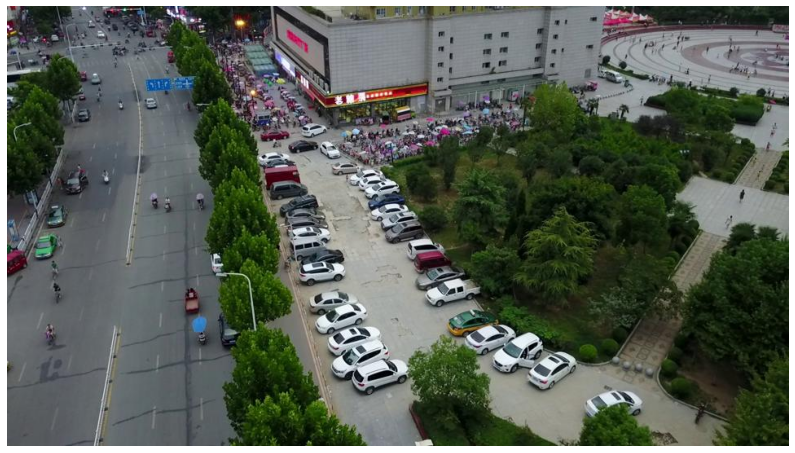

Annotation:
684,8,273,116,0,0,0,0
406,119,265,70,0,0,0,0
255,22,119,128,0,0,0,0
1,3,209,78,0,0,0,0
708,471,74,33,1,4,0,1
639,425,61,46,1,4,0,0
594,399,64,51,1,4,0,0
562,390,61,38,1,4,0,0
540,372,65,33,1,4,0,1
514,333,68,35,1,4,0,0
501,317,64,31,1,4,0,1
501,299,45,28,1,4,0,1
489,284,48,27,1,4,0,1
463,262,48,29,1,4,0,0
458,252,49,22,1,4,0,1
448,242,45,20,1,4,0,1
442,230,49,19,1,4,0,1
439,214,45,21,1,4,0,1
429,208,42,19,1,4,0,1
420,199,43,20,1,4,0,1
398,188,41,18,1,4,0,1
46,391,14,26,1,2,0,0
421,433,74,44,1,4,0,1
369,346,64,34,1,4,0,0
398,410,72,46,1,4,0,1
394,393,70,36,1,4,0,1
377,364,71,38,1,4,0,0
357,312,58,31,1,4,0,0
359,298,54,22,1,4,0,2
348,283,43,28,1,5,0,1
345,271,52,19,1,4,0,1
340,260,60,18,1,5,0,1
340,250,52,16,1,4,0,1
332,231,54,22,1,5,0,1
323,213,45,25,1,5,0,0
317,195,45,31,1,6,0,1
316,188,36,15,1,4,0,2
308,179,44,17,1,4,0,1
345,163,37,18,1,4,0,0
384,164,26,22,1,4,0,1
43,398,18,17,1,10,0,1
324,167,14,6,1,3,0,0
362,143,30,18,1,4,1,0
310,150,36,15,1,4,0,0
258,375,30,43,1,4,0,2
2

In [3]:
'''
Load first image as np array and show it
'''
first_img = cv2.imread(train_imgs[0])
first_img = cv2.cvtColor(first_img, cv2.COLOR_BGR2RGB)

print('First image:')
fig = plt.figure(num=1, figsize=(14, 14))
plt.imshow(first_img)
plt.xticks([]), plt.yticks([])
plt.axis('off')
plt.show()

'''
Show first annotation
'''
print('Annotation:')
with open(train_labels[0], 'r') as f:
    lines = f.readlines()
    for line in lines:
        print(line.strip())



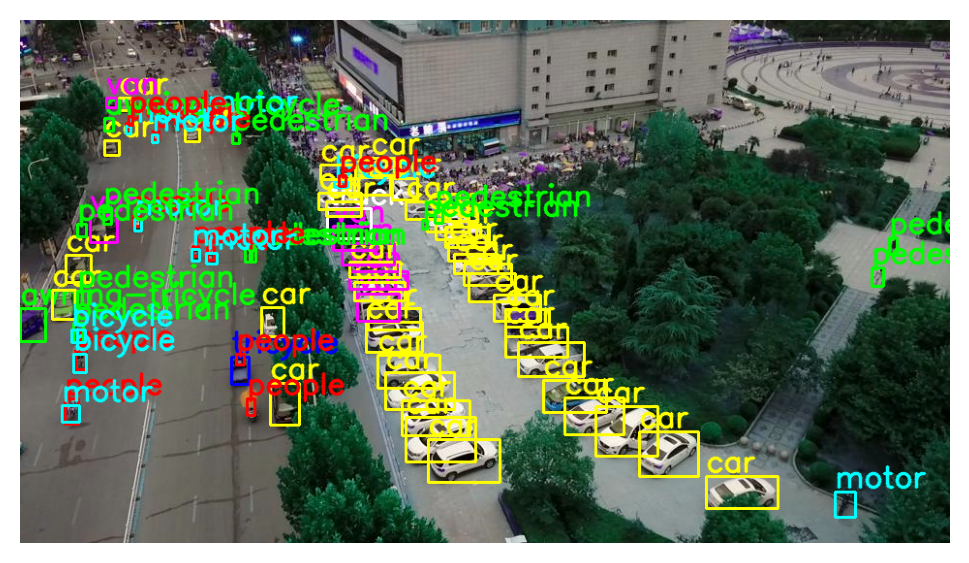

In [4]:
'''
Show first annotated image
'''

first_label = create_label(train_labels[0])
im_np = annotate_img(first_img, first_label, class_dict)


#### 2. Holdout dataset split as specified

The dataset comes split into three different folders - train, validation, and test. I need to put the images and annotations into CSV format for training. I will use approximately 1/4 of the size of each dataset.

In [5]:
'''
List the number of images in train, validation, and test sets
'''
!ls VisDrone2019-DET-train/images/ | wc -l
!ls VisDrone2019-DET-val/images/ | wc -l
!ls VisDrone2019-DET-test/images/ | wc -l

6471
548
1610


In [2]:
'''
Creae a CSV for each set
'''
train_size = 500
val_size = 50
test_size = 100
create_CSV(dir_train,train_size,'train.csv',class_dict)
create_CSV(dir_valid,val_size,'valid.csv',class_dict)
create_CSV(dir_test,test_size,'test.csv',class_dict)

#### 3. Correct explanation generalization from such a holdout split

The train and validation sets are used when training the retinanet model. As the model trains, predictions are made on the validation set to determine the accuracy of the network. The holdout (aka test) set is used on to compare the effectiveness of final model against other models.

#### 4. Printout of dataset distribution, including missing data. For imagery datasets, provide the "average image" for each class. For tabular data, use `value_counts()` and `describe()`. For textual data, show the distribution of your labels/targets.

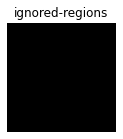

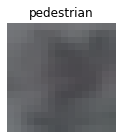

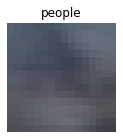

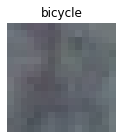

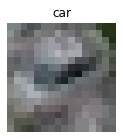

...

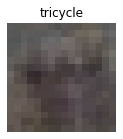

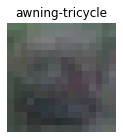

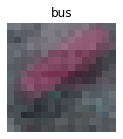

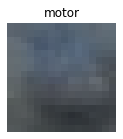

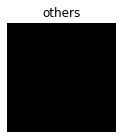

In [3]:
'''
Show the average class in the train set by averaging the bounding boxes from num_avg bounding boxes into a dim shaped image
'''
df_labels = pd.read_csv('train.csv')
df_labels.columns = ['img_path', 'x1', 'y1', 'x2', 'y2', 'label']
classes = class_dict.values()
dim = (16,16)
num_avg = 10

for c in classes:
    df_class = df_labels[df_labels['label'] == c]
    avg_class = np.zeros((num_avg,dim[0],dim[1],3),dtype=np.float64)

    i = 0
    for idx,row in df_class[:num_avg].iterrows():
        img = cv2.imread(row['img_path'])

        y1 = int(row['y1'])
        y2 = int(row['y2'])
        x1 = int(row['x1'])
        x2 = int(row['x2'])
        car = img[y1:y2,x1:x2]

        avg_class[i] = cv2.resize(car,dim)
        i+=1

    avg = np.array(np.mean(avg_class, axis=(0)), dtype=np.uint8)

    fig = plt.figure(figsize=(2,2))
    ax = fig.add_subplot(1,1,1)
    ax.imshow(cv2.cvtColor(avg, cv2.COLOR_BGR2RGB))
    ax.axis('off')
    ax.set_title(c)

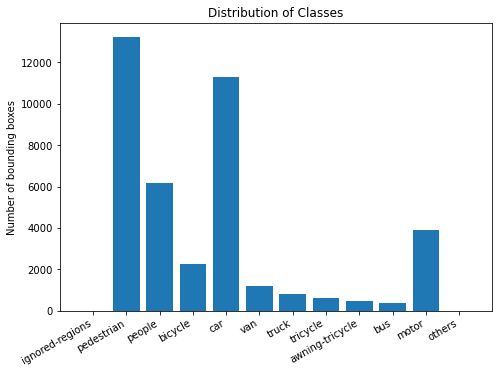

In [23]:
'''
Show a bar graph of distributions bounding boxes by class
'''
label_dist = {}
for c in classes:
    label_dist[c] = len(df_labels[df_labels['label'] == c])

fig = plt.figure()
ax = fig.add_axes([0,0,1,1])
ax.bar(label_dist.keys(),label_dist.values())
ax.set_ylabel('Number of bounding boxes')
plt.title('Distribution of Classes')
plt.xticks(rotation=30, ha='right')
plt.show()


#### 5. Discussion of how the dataset distribution can/will affect your modeling.

There is a pretty substantial class imbalance. There are many pedestrian and car instances, so the model will be accurate when identifying them, but other classes, like awning-tricycle, might not be detected since there are a lot fewer of them for the model to train on.

#### 6. Handle any missing data. For imagery/text datasets, discuss what records/items you might drop and why.
This dataset did not have missing data as every image file had a corresponding annotation file.

The Retinanet model takes as inputs images and annotations when it is training. Both images and annotations can have issues. I will keep all images for now, and instead focus on getting clean annotations. The dataset lists several parameters for each image annotation. [Info from here](https://github.com/dronefreak/VisDrone-dataset-python-toolkit)

| Parameter       | Description                                                                  |
|-----------------|------------------------------------------------------------------------------|
| bbox_left       | The x coordinate of top-left corner of predicted bounding box                |
| bbox_top        | The y coordinate of the top-left corner of the predicted object bounding box |
| bbox_width      | The width in pixels of the predicted object bounding box                     |
| score           | The confidence of the ground truth bounding box instance 0 or 1              |
| object_category | Type of the annotated object 0-11                                            |
| truncation      | Indicates the degree of which the object appears outside image frame 0 or 1  |
| occlusion       | Indicates the fraction of object being occluded 0, 1, or 2                   |


Bounding boxes around objects that are occluded may be hard for the object to identify, same with truncation. Removing these from the dataset would likely improve accuracy of the model. However, the model would not perform well in the real world where objects may be naturally truncated or occluded. Therefore, it is best to leave the truncated and occluded bounding boxes in the dataset to have the model generalize well in real world environments.

The only bounding boxes I would drop are records who have a score == 0, since they have a low ground truth confidence.



#### 7. The holdout dataset also contains missing data/bad images/text. Discuss how you handled this in your holdout, or why it was not a problem for you.

The holdout dataset was not a problem for me, since I also used the same preprocessing steps as the train dataset - any bounding box annotation where the ground truth is 1 will be used, and any with 0 will be ignored.

#### 8. Discuss (and implement if applicable) whether or not you need to scale/normalize your features, and which ones, if any, for tabular data or imagery. For textual data, display the outputs of the word embeddings and discuss why they look the way they do.

I will normalize the pixel values of the image so that the mean and standard deviation of the image match the mean and standard deviation of the dataset. Also I will scale the dimensions of the input image so it matches the input dimension of the model.

In [3]:
'''
Normalize image pixel values based on the mean and standard deviation of the dataset
'''

# calculate the mean and std of the dataset using downsampled images in the DataLoader
# Source: https://www.binarystudy.com/2021/04/how-to-calculate-mean-standard-deviation-images-pytorch.html
batch_size = 2
temp_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(256),
    transforms.ToTensor()])

image_data = datasets.ImageFolder(root=dir_train, transform=temp_transform)

loader = DataLoader(
  image_data,
  batch_size = batch_size,
  num_workers=1)

def batch_mean_and_sd(loader):

    cnt = 0
    fst_moment = torch.empty(3)
    snd_moment = torch.empty(3)

    for images, _ in loader:
        b, c, h, w = images.shape
        nb_pixels = b * h * w
        sum_ = torch.sum(images, dim=[0, 2, 3])
        sum_of_square = torch.sum(images ** 2,
                                  dim=[0, 2, 3])
        fst_moment = (cnt * fst_moment + sum_) / (cnt + nb_pixels)
        snd_moment = (cnt * snd_moment + sum_of_square) / (cnt + nb_pixels)
        cnt += nb_pixels

    mean, std = fst_moment, torch.sqrt(snd_moment - fst_moment ** 2)
    return mean,std

mean, std = batch_mean_and_sd(loader)
mean = mean.tolist()
std = std.tolist()
print('mean:')
print(mean)
print('std:')
print(std)

mean:
[0.38516947627067566, 0.39026349782943726, 0.3755533993244171]
std:
[0.22190919518470764, 0.22177447378635406, 0.2310042828321457]


In [4]:
normalizer = Normalizer(mean, std)

'''
Scale images to match the input dimensions of the model
'''
resizer = Resizer(min_side=608, max_side=1024)

#### 9. If your dataset has categorical features: discuss and implement if you will encode them as ordinal numbers, or one-hot encode them, and why you chose to do so for each such feature. If you are using images/text, discuss whether you are performing classification or regression on your dataset and why (instead of the other one).

The labels of each bounding box are encoded as ordinal numbers. They are labeled in the dataset with the following numbering scheme:
```
label_dict = {0: 'ignored-regions',
              1: 'pedestrian',
              2: 'people',
              3: 'bicycle',
              4: 'car',
              5: 'van',
              6: 'truck',
              7: 'tricycle',
              8: 'awning-tricycle',
              9: 'bus',
              10: 'motor',
              11: 'others'
              }
```
While I could one-hot encode the labels, the Retinanet model implemented in Pytorch outputs a tensor with ordinal labels (corresponding to the training set). Since this is how the model works internally, I will keep the labels as ordinal.


#### 10. Give an example of an ordinal feature that you've seen used by others, when it should have been treated as a categorical.
A model that tries to predict a persons favorite color based on the ice cream flavors they like. If the ice cream was one ordinal feature, then it might be encoded as 1: strawberry, 2: vanilla, 3: chocolate, ... This encoding is not good because there is no relationship between the value the flavor is assigned and the flavor itself. It would be better to one hot encode the flavors. E.g. (0, 1, 0) for vanilla.

#### 11. For tabular data: Use a heatmap to show the correlation between all feature pairs. Discuss, if any, which features you would recommend dropping from your model. Also discuss why you would want to drop them (what is the expected benefit?). For imagery/text: Show a histogram of the distribution of pixels or word embeddings across your dataset.

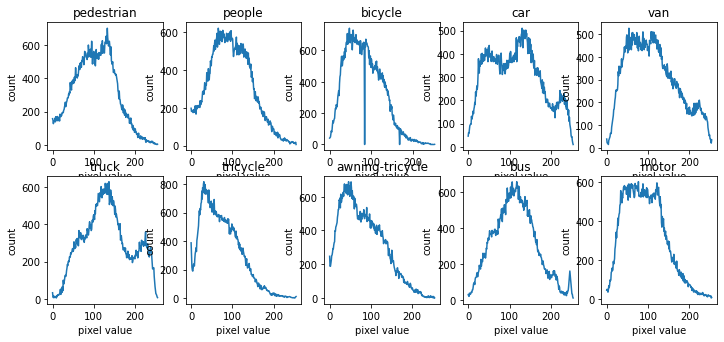

In [24]:
'''
Calculate the distribution of pixels contained within the bounding box of each class over a sample of 100 images
'''
dim = (16,16)
num_avg = 100

j = 0
for c in classes:
    df_class = df_labels[df_labels['label'] == c]
    avg_class = np.zeros((num_avg,dim[0],dim[1],3),dtype=np.float64)

    i = 0
    for idx,row in df_class[:num_avg].iterrows():
        img = cv2.imread(row['img_path'])

        y1 = int(row['y1'])
        y2 = int(row['y2'])
        x1 = int(row['x1'])
        x2 = int(row['x2'])
        car = img[y1:y2,x1:x2]

        avg_class[i] = cv2.resize(car,dim)
        i+=1
    j+=1

    if len(df_class) > 0:
        fig = plt.figure(num=1, figsize=(12, 8))
        # draw the corresponding histogram
        plt.subplot(3, 5, j-1)
        avg_class = avg_class.reshape(-1)
        histogram, bin_edges = np.histogram(avg_class, bins=256)
        plt.xlabel("pixel value")
        plt.ylabel("count")
        plt.plot(bin_edges[0:256], histogram)
        plt.title(c)


#### 12. Discuss what feature you would engineer (and implement) if using tabular data, what customized dataset augmentation you would use (not required to implement) if images, or what non-standard pre-processing might help, if text

Some dataset augmentation for the dataset images include image flipping, rotations, scaling, and cropping. Since the images are taken from a high angle, I think horizontal flipping, scaling, and cropping would make for the most realistic data augmentation.

In [5]:
'''
Augment the data by flipping horizontally
'''
augmenter = Augmenter()

#### 13. Separate your training data into features and labels.
The training data is already split into features (the images) and labels (the annotations).

#### 14. Discuss and implement how you will handle any dataset imbalance.

The high category imbalance of the dataset makes it difficult to identify the less common vehicles. Of the 10 categories, I think pedestrians and cars are most important, since they are also the most common objects in urban environments. Therefore, I do not think it is as important to get high accuracy on the less common vehicles like awning-tricycles.

A related issue is the high category imbalance between background and foreground objects. Since the detected object make up only a small fraction of the image (especially from high altitude images), there are many more background instances than objects. These background instances can overpower the loss function and prevent the model from learning from the foreground objects.

[Retinanet](https://arxiv.org/pdf/1708.02002.pdf) solves this issue by introducing a novel loss, dubbed Focal loss, which adds a factor to the standard cross entropy loss. The factor reduces the relative loss for well-classified examples and puts more focus on hard, misclassified examples. The original paper achieved a highly accurate object detector in the presence of vast numbers of easy background examples.

#### 15. Instantiate a model of your choosing.
#### 27. Instantiate any pre-trained model. Discuss why you chose it amongst the others.
I used retinanet models with a pre-trained resnet50 backbone on the COCO dataset. If I did not use pre-trained weights, the model would take a lot longer to converge since it is at least 50 layers deep.
#### 29. Replace the head of the model with sequential layer(s) to predict however many classes you need
This is done by setting the `num_classes` parameter in `model.resnet50(num_classes)`. Internally, this changes the dimensions of the final convolutional layers of the classification and bounding box regression subnetworks.
#### 35. Write code that places the model on the GPU, if it exists, otherwise using the CPU.


In [6]:
'''
Create an instance of retinanet with a resnet50 backbone
'''
def create_retinanet(pretrained=True):
    retinanet = model.resnet50(num_classes=len(classes), pretrained=pretrained)
    retinanet = retinanet.cuda()
    # Use dataparallel to split training on GPUs
    if torch.cuda.is_available():
        retinanet = torch.nn.DataParallel(retinanet).cuda()
    else:
        retinanet = torch.nn.DataParallel(retinanet)

    return retinanet


#### 30. What activation function did you use in the step above? Why?
This uses a Sigmoid activation function. We want the output of the model to be a probability between 0 and 1. The sigmoid function ranges from 0 to 1.
#### 31. Did you use dropout in the step above? Why or why not?
I did not use dropout as the authors of the retinanet paper did not use dropout. To select the best classifications, they instead only take the highest 1k predictions from the final classification layer and ignore the rest.
#### 32. Did you use batch normalization in the step above? Why or why not?
Yes. Batch normalization is used within resnet backbone. I did not alter how that works.

#### 16. Define a grid to tune at least three different hyperparameters with at least two different values each. Discuss why you think these parameter values might be useful for this dataset.
- Epochs: The number of times to train the model on the dataset
- Learning rate: The learning rate determines how much to adjust the weights based on the gradient. Finding the best learning rate helps the model converge onto the optimal set of weights.
- Batch size: The batch size is the number of images the model trains on before updating weights. Having too few images in the batch will make the model over fit to the image while having too many will prevent the model from learning specific characteristics from each image.
- Patience: This parameter is part of a scheduler which will decrease the learning rate once it has plateaued over `pateince` number of epochs. This helps improve the model by making finer adjustments to the weights.

In [9]:
grid = {
    'epochs': [5], # I set this low for the sake of time, since gridsearchCV takes a very long time to run
    'learning_rate': [0.001, 0.00001],
    'batch_size': [4,2], # batch_size < 5, or else CUDA out of memory
    'patience': [1,3]
}

## Training
#### 17. Set up a gridsearchCV with 5-fold cross validation (scikit-learn) or equivalent in PyTorch. Discuss what accuracy metric you chose and why.
Mean Average Precision (mAP). This score accounts for the intersection over union (IoU), which measures how close the bounding box prediction is to the ground truth. The higher the mAP, the better the model.
#### 24. For images, define a list of image transformations to be used during training, passing them to `transforms.Compose()`. For text and tabular data, discuss what pre-processing you used. Discuss why you think these transformations might help.
I applied normalization, scaling, and augmentation (randomly flipping horizontally). These transformations help make the input data more uniform. This helps the model generalize and not get thrown off by outliers in the training set.
#### 25. Repeat the step above for test and validation transformations.
I apply the same transformations in the next cell for the validation set, and the cell below for the test set.
#### 26. Correctly set up `DataLoaders` for the three folders (train, validation, holdout). Discuss hwat options you chose for these loaders, and why (including batch size, shuffling, and dropping last).
I used a dataloader where batch size is set to the hyperparameter of the grid search. There is also the `collate_fn` which is for setting up pairs of images and annotations as a batch.
#### 28. Write code to freeze/unfreeze the pre-trained model layers.
The pre-trained layers are frozen by using `retinanet.module.freeze_bn()` which freezes the batch normalized layers of the resnet backbone.
#### 33. Choose and instantiate an optimizer. Discuss your choice.
I am using an adam optimizer because it is a common optimizer that uses stochastic gradient descent.
#### 34. Choose and instantiate a loss function. Discuss your choice.
The retinanet comes with two loss functions that have already been implemented, one for the classification subnet and one for the bounding box subnet. There is the focal loss term, which is applied to the classification subnet. Focal loss $FL(p_t)=-(1-p_t)^\gamma logp_t$ where $p_t$ is the model's estimated probability and $\gamma$ is the tuneable focusing parameter. The bounding box subnet uses a convolutional bounding box regression. The final loss term is the sum of the mean of both losses over the batch.
#### 37. Correctly set up your model to use your batches for training
#### 39. Correctly choose a loss function and back-propagate its results.
#### 40. Use the optimizer correctly to update weights/gradients.


In [7]:
'''
Define a train function to be used by cross validation
'''
def train(train_name,valid_name,epochs,learning_rate,batch_size,patience,model_name,pretrained=True):
    csv_classes = 'classes.csv'
    # Create the data loader
    dataset_train = CSVDataset(train_file=train_name, class_list=csv_classes,transform=transforms.Compose([normalizer, augmenter, resizer]))

    if valid_name is None:
        dataset_val = None
        print('No validation annotations provided.')
    else:
        dataset_val = CSVDataset(train_file=valid_name, class_list=csv_classes,transform=transforms.Compose([normalizer, augmenter, resizer]))

    sampler = AspectRatioBasedSampler(dataset_train, batch_size=batch_size, drop_last=False)

    dataloader_train = DataLoader(dataset_train, num_workers=3, collate_fn=collater, batch_sampler=sampler)

    if dataset_val is not None:
        sampler_val = AspectRatioBasedSampler(dataset_val, batch_size=1,     drop_last=False)
        dataloader_val = DataLoader(dataset_val, num_workers=3, collate_fn=collater, batch_sampler=sampler_val)


    # Create the model
    retinanet = create_retinanet(pretrained)

    retinanet.training = True

    optimizer = optim.Adam(retinanet.parameters(), lr=learning_rate)

    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=patience, verbose=True)

    loss_hist = collections.deque(maxlen=500)


    retinanet.train()
    retinanet.module.freeze_bn()


    print('Num training images: {}'.format(len(dataset_train)))



    for epoch_num in range(epochs):

        retinanet.train()
        retinanet.module.freeze_bn()

        epoch_loss = []

        for iter_num, data in enumerate(dataloader_train):
            try:
                optimizer.zero_grad()

                if torch.cuda.is_available():
                    classification_loss, regression_loss = retinanet([data['img'].cuda().float(), data['annot']])
                else:
                    classification_loss, regression_loss = retinanet([data['img'].float(), data['annot']])

                classification_loss = classification_loss.mean()
                regression_loss = regression_loss.mean()

                loss = classification_loss + regression_loss

                if bool(loss == 0):
                    continue

                loss.backward()

                torch.nn.utils.clip_grad_norm_(retinanet.parameters(), 0.1)

                optimizer.step()

                loss_hist.append(float(loss))

                epoch_loss.append(float(loss))

                print(
                    'Epoch: {} | Iteration: {} | Classification loss: {:1.5f} | Regression loss: {:1.5f} | Running loss: {:1.5f}'.format(
                    epoch_num, iter_num, float(classification_loss), float(regression_loss), np.mean(loss_hist)))


                del classification_loss
                del regression_loss
            except Exception as e:
                print(e)
                continue


        if valid_name is not None:

            print('Evaluating dataset')

            mAP = csv_eval.evaluate(dataset_val, retinanet)

        scheduler.step(np.mean(epoch_loss))

        #torch.save(retinanet.module, 'trained_model/{}_epoch_{}.pt'.format(model_name, epoch_num))

    retinanet.eval()

    torch.save(retinanet, 'trained_model/{}_final.pt'.format(model_name))
    return mAP



In [8]:
'''
Helper function to split a CSV into folds
'''
def split_folds(csv,num_folds,iter):
    '''
    csv: csv file to split into folds
    num_folds: number of folds
    iter: 0-4 the current iteration
    '''
    df = pd.read_csv(csv,header=None,names=['img_path', 'x1', 'y1', 'x2', 'y2', 'label'])

    unique_paths = df['img_path'].unique()
    num = len(unique_paths)
    valid_size = int(num/num_folds)
    start_valid = valid_size * iter
    end_valid = start_valid + valid_size

    # get the image paths between start_valid and end_valid
    valid_paths = unique_paths[start_valid:end_valid]
    #valid = df[[df['img_path'].isin(valid_paths)]]
    valid = df[df['img_path'].isin(valid_paths)]
    train = df.drop(df.index[df['img_path'].isin(valid_paths)])

    return train, valid

'''
Implementation of gridsearchCV to run model on grid of parameters with cross validation
'''
def gridsearchCV(train_csv, grid):
    # split csv into 5 folds
    num_folds = 5

    # keep track of scores
    performances = []
    best_mAP = 0
    best_performance = ''

    for fold in range(num_folds):
        print('Starting Fold {}'.format(fold))

        train_df, valid_df = split_folds(train_csv, num_folds, fold)
        train_name = 'train_fold_{}.csv'.format(fold)
        valid_name = 'valid_fold_{}.csv'.format(fold)

        train_df.to_csv(train_name,header=False,index=False)
        valid_df.to_csv(valid_name,header=False,index=False)

        for epochs in grid['epochs']:
            for learning_rate in grid['learning_rate']:
                for batch_size in grid['batch_size']:
                    for patience in grid['patience']:
                        print('Parameters:')
                        print('\tEpochs: {}'.format(epochs))
                        print('\tLearning Rate: {}'.format(learning_rate))
                        print('\tBatch Size: {}'.format(batch_size))
                        print('\tPatience: {}'.format(patience))

                        model_name =     'model_fold-{}_e-{}_lr-{}_bs-{}_p-{}.pt_final.pt'.format    (fold,epochs,learning_rate,batch_size,patience)
                        performance = {
                            'fold': i,
                            'epochs': epochs,
                            'learning_rate': learning_rate,
                            'batch_size': batch_size,
                            'patience': patience,
                            'model_name': model_name,
                            'mAP': 0
                        }

                        APs = train(train_name,valid_name,epochs,learning_rate,batch_size,patience,model_name,pretrained=True)

                        APs = list(APs.values())
                        APs = [float(tup[0]) for tup in APs]
                        mAP = sum(APs)/len(APs)
                        print('mAP: {}'.format(mAP))

                        performance['mAP'] = mAP
                        if mAP > best_mAP:
                            best_mAP = mAP
                        best_performance = model_name

                    print('Performance: {}'.format(performance['mAP']))

    print(performances)
    print('Best performance: {}'.format(best_performance))
    return best_performance, performances



#### 18. Train your model using grid search (or equivalent), and report the best performing hyperparameters.

In [16]:
best_performance, performances = gridsearchCV('train.csv',grid)

Starting Fold 0
Parameters:
	Epochs: 5
	Learning Rate: 0.001
	Batch Size: 4
	Patience: 1
Num training images: 400
Epoch: 0 | Iteration: 0 | Classification loss: 1.26882 | Regression loss: 1.03004 | Running loss: 2.29886
Epoch: 0 | Iteration: 1 | Classification loss: 369.34930 | Regression loss: 5.11075 | Running loss: 188.37946
Epoch: 0 | Iteration: 2 | Classification loss: 2.14286 | Regression loss: 7.46732 | Running loss: 128.78970
Epoch: 0 | Iteration: 3 | Classification loss: 1.87058 | Regression loss: 3.57509 | Running loss: 97.95369
Epoch: 0 | Iteration: 4 | Classification loss: 3.77106 | Regression loss: 1.20850 | Running loss: 79.35887
Epoch: 0 | Iteration: 5 | Classification loss: 1.41462 | Regression loss: 1.04043 | Running loss: 66.54156
Epoch: 0 | Iteration: 6 | Classification loss: 1.09436 | Regression loss: 2.89488 | Running loss: 57.60552
Epoch: 0 | Iteration: 7 | Classification loss: 1.15313 | Regression loss: 1.06098 | Running loss: 50.68159
Epoch: 0 | Iteration: 8 | C

Traceback (most recent call last):
  File "/home/test/anaconda3/envs/pytorch/lib/python3.8/multiprocessing/queues.py", line 245, in _feed
    send_bytes(obj)
  File "/home/test/anaconda3/envs/pytorch/lib/python3.8/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/home/test/anaconda3/envs/pytorch/lib/python3.8/multiprocessing/connection.py", line 411, in _send_bytes
    self._send(header + buf)
  File "/home/test/anaconda3/envs/pytorch/lib/python3.8/multiprocessing/connection.py", line 368, in _send
    n = write(self._handle, buf)
BrokenPipeError: [Errno 32] Broken pipe


KeyboardInterrupt: 

In [9]:
best_performance = 'model_fold-1_e-5_lr-1e-05_bs-2_p-1.pt_final.pt'
print(best_performance)

model_fold-1_e-5_lr-1e-05_bs-2_p-1.pt_final.pt


| Combination | Learning rate | Batch size | Patience | Fold 0 mAP | Fold 1 mAP |
|---|----------|---------------|------------|----------|------------|------------|
| 1| 0.001    | 4          | 1        | 0.0013     | 0.00075    |
| 2| 0.001    | 4          | 3        | 0.0        | 0.0016     |
| 3| 0.001    | 2          | 1        | 0.0023     | 0.0058     |
| 4| 0.001    | 2          | 3        | 0.0        | 0.0016     |
| 5| 0.00001  | 4          | 1        | 0.0168     | 0.013 |
| 6| 0.00001  | 4          | 3        | 0.0135     | 0.013 |
| 7| 0.00001  | 2          | 1        | 0.0138     | 0.0202 |
| **8**| **0.00001**  | **2**          | **3**        | **0.0161**     | **0.0203** |

I stopped `gridsearchCV()` after two folds since it takes 5+ hours to run each fold. The most significant parameter was the learning rate, with all models with a learning rate of 0.00001 scoring at least 10 times better than models with a learning rate of 0.001. Nearly all models with a patience of 1 scored better than those with a patience of 3. There wasn't as clear a trend for the batch size of 4 versus 2.

The best model was #8 with a learning rate of 0.00001, batch size of 2, and patience of 3.



#### 36. Correctly set up your model to train over 20 epochs.
#### 41. Correctly record training losses for each epoch.
#### 42. Correctly set up validation at each epoch.
#### 43. Correctly record validation losses for each epoch.
#### 44. Correctly record training and validation accuracies for each epoch.
As I will mention in a few cells (rubric 19), I cannot calculate accuracy in an object detection model due to not being able to calculate true negatives. Instead I calculate the Mean Average Precicion (mAP).

In [10]:
'''
Define a train function to log the train and validation loss and mean average precision
'''
def train_val_loss(train_name,valid_name,epochs,learning_rate,batch_size,patience,model_name,pretrained=True):
    csv_classes = 'classes.csv'
    # Create the data loader
    dataset_train = CSVDataset(train_file=train_name, class_list=csv_classes,transform=transforms.Compose([normalizer, augmenter, resizer]))
    dataset_train_mAP = CSVDataset(train_file=train_name, class_list=csv_classes,transform=transforms.Compose([normalizer, augmenter, resizer]))

    if valid_name is None:
        dataset_val = None
        print('No validation annotations provided.')
    else:
        dataset_val = CSVDataset(train_file=valid_name, class_list=csv_classes,transform=transforms.Compose([normalizer, augmenter, resizer]))
        dataset_val_mAP = CSVDataset(train_file=valid_name, class_list=csv_classes,transform=transforms.Compose([normalizer, augmenter, resizer]))

    sampler = AspectRatioBasedSampler(dataset_train, batch_size=batch_size, drop_last=False)

    dataloader_train = DataLoader(dataset_train, num_workers=3, collate_fn=collater, batch_sampler=sampler)

    if dataset_val is not None:
        sampler_val = AspectRatioBasedSampler(dataset_val, batch_size=2,     drop_last=False)
        dataloader_val = DataLoader(dataset_val, num_workers=3, collate_fn=collater, batch_sampler=sampler_val)


    # Create the model
    retinanet = create_retinanet(pretrained)

    retinanet.training = True

    optimizer = optim.Adam(retinanet.parameters(), lr=learning_rate)

    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=patience, verbose=True)

    loss_hist = collections.deque(maxlen=500)
    loss_hist_v = collections.deque(maxlen=500)


    retinanet.train()
    retinanet.module.freeze_bn()


    print('Num training images: {}'.format(len(dataset_train)))


    train_loss = []
    val_loss = []
    train_mAP = []
    val_mAP = []

    for epoch_num in range(epochs):

        retinanet.train()
        retinanet.module.freeze_bn()

        epoch_loss = []

        for iter_num, data in enumerate(dataloader_train):
            try:
                optimizer.zero_grad()

                if torch.cuda.is_available():
                    classification_loss, regression_loss = retinanet([data['img'].cuda().float(), data['annot']])
                else:
                    classification_loss, regression_loss = retinanet([data['img'].float(), data['annot']])

                classification_loss = classification_loss.mean()
                regression_loss = regression_loss.mean()

                loss = classification_loss + regression_loss

                if bool(loss == 0):
                    continue

                loss.backward()

                torch.nn.utils.clip_grad_norm_(retinanet.parameters(), 0.1)

                optimizer.step()

                loss_hist.append(float(loss))

                epoch_loss.append(float(loss))


                print(
                    'Epoch: {} | Iteration: {} | Classification loss: {:1.5f} | Regression loss: {:1.5f} | Running loss: {:1.5f}'.format(
                    epoch_num, iter_num, float(classification_loss), float(regression_loss), np.mean(loss_hist)))

                del classification_loss
                del regression_loss
            except Exception as e:
                print(e)
                continue

        train_loss.append(float(np.mean(loss_hist)))


        if valid_name is not None:


            '''
            Calculate validation loss
            '''
            for _, data in enumerate(dataloader_val):
                try:
                    optimizer.zero_grad()

                    if torch.cuda.is_available():
                        classification_loss, regression_loss = retinanet([data['img'].cuda().float(), data['annot']])
                    else:
                        classification_loss, regression_loss = retinanet([data['img'].float(), data['annot']])

                    classification_loss = classification_loss.mean()
                    regression_loss = regression_loss.mean()

                    loss = classification_loss + regression_loss
                    loss_hist.append(float(loss))

                    del classification_loss
                    del regression_loss

                except Exception as e:
                    print(e)
                    continue

            val_loss.append(float(np.mean(loss_hist)))

            print('Evaluating dataset train:')
            train_APs = csv_eval.evaluate(dataset_train_mAP, retinanet)
            train_APs = list(train_APs.values())
            train_APs = [float(tup[0]) for tup in train_APs]
            train_mAP.append(sum(train_APs)/len(train_APs))


            print('Evaluating dataset val:')
            val_APs = csv_eval.evaluate(dataset_val_mAP , retinanet)
            val_APs = list(val_APs.values())
            val_APs = [float(tup[0]) for tup in val_APs]
            val_mAP.append(sum(val_APs)/len(val_APs))

            print('train mAP: {}'.format(train_mAP))
            print('val mAP: {}'.format(val_mAP))

        scheduler.step(np.mean(epoch_loss))


    retinanet.eval()

    torch.save(retinanet, 'trained_model/{}_final.pt'.format(model_name))
    return train_mAP, val_mAP, train_loss, val_loss


In [15]:
'''
Train model 20 epochs using best hyperparameters
'''

# increase size of dataset
train_size = 1000
val_size = 100
test_size = 200
create_CSV(dir_train,train_size,'train.csv',class_dict)
create_CSV(dir_valid,val_size,'valid.csv',class_dict)
create_CSV(dir_test,test_size,'test.csv',class_dict)

epochs = 20
batch_size = 2
learning_rate = 0.00001
patience = 3
train_name = 'train.csv'
valid_name = 'valid.csv'
model_name = 'epochs_20.pt'

train_mAPs, val_mAPs, train_loss, val_loss = train_val_loss(train_name,valid_name,epochs,learning_rate,batch_size,patience,model_name,pretrained=True)


print(train_loss)
print(val_loss)


Num training images: 1000
Epoch: 0 | Iteration: 0 | Classification loss: 1.13082 | Regression loss: 1.03265 | Running loss: 2.16347
Epoch: 0 | Iteration: 1 | Classification loss: 1.12742 | Regression loss: 1.03002 | Running loss: 2.16046
Epoch: 0 | Iteration: 2 | Classification loss: 1.11492 | Regression loss: 1.03926 | Running loss: 2.15837
Epoch: 0 | Iteration: 3 | Classification loss: 1.10931 | Regression loss: 0.96862 | Running loss: 2.13826
Epoch: 0 | Iteration: 4 | Classification loss: 1.08452 | Regression loss: 1.03682 | Running loss: 2.13487
Epoch: 0 | Iteration: 5 | Classification loss: 1.10018 | Regression loss: 1.05639 | Running loss: 2.13849
Epoch: 0 | Iteration: 6 | Classification loss: 1.09165 | Regression loss: 1.00339 | Running loss: 2.13228
Epoch: 0 | Iteration: 7 | Classification loss: 0.93168 | Regression loss: 1.01922 | Running loss: 2.10961
Epoch: 0 | Iteration: 8 | Classification loss: 0.95843 | Regression loss: 1.06961 | Running loss: 2.10055
Epoch: 0 | Iteration

#### 45. Graph training versus validation loss using `matplotlib.pyplot` (or other). Was your model overfitting, underfitting, or neither?

The model was neither overfitting or underfitting. Both the training and validation loss decrease over the number of epochs. The validation loss stays very close to the training loss, so the model was not overfitting.

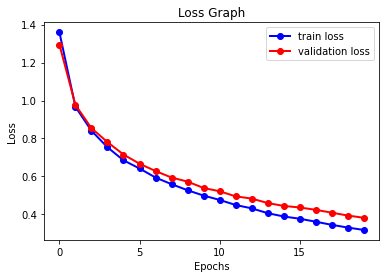

In [17]:
# draw training vs validation loss
plt.plot(train_loss, 'b-o', label='train loss', lw=2)
plt.plot(val_loss, 'r-o', label='validation loss', lw=2)
plt.title('Loss Graph')
plt.legend()
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.xticks(range(0,20,5))
plt.show()


#### 48. Graph training versus validation accuracy using `matplotlib.pyplot` (or other). Score your model on its predictions on the holdout. Discuss why you think your results will or will not generalize.

The mean average precision (mAP) of the model increases over the number of epochs for both the train and validation set. The mAP on the holdout set was 0.01358 (calculated two cells below). The validation mAP was 0.0302. I believe the model will generalize, since the validation mAP is not too far off (it is of the same order of magnitude as the validation mAP).

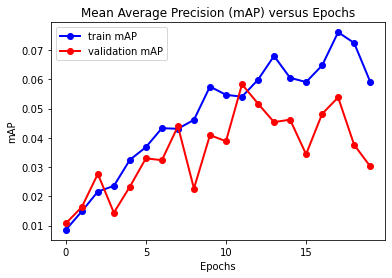

In [18]:
# draw training vs validation mAP
plt.plot(train_mAPs, 'b-o', label='train mAP', lw=2)
plt.plot(val_mAPs, 'r-o', label='validation mAP', lw=2)
plt.title('Mean Average Precision (mAP) versus Epochs')
plt.legend()
plt.xlabel('Epochs')
plt.ylabel('mAP')
plt.xticks(range(0,20,5))
plt.show()


#### 21. Generate a confusion matrix and discuss your results.

500/500
mAP:
ignored-regions: 0
Precision:  0.014500941619585688
Recall:  0.05682656826568266
pedestrian: 0.007604782449623529
Precision:  0.014500941619585688
Recall:  0.05682656826568266
people: 0.0005666343201530331
Precision:  0.014500941619585688
Recall:  0.05682656826568266
bicycle: 0.0009799246273220347
Precision:  0.014500941619585688
Recall:  0.05682656826568266
car: 0.07719163964550754
Precision:  0.014500941619585688
Recall:  0.05682656826568266
van: 0.01020810903092297
Precision:  0.014500941619585688
Recall:  0.05682656826568266
truck: 0.03645491543020179
Precision:  0.014500941619585688
Recall:  0.05682656826568266
tricycle: 0.003318029149217266
Precision:  0.014500941619585688
Recall:  0.05682656826568266
awning-tricycle: 0.006106204748805626
Precision:  0.014500941619585688
Recall:  0.05682656826568266
bus: 0.013969238611165431
Precision:  0.014500941619585688
Recall:  0.05682656826568266
motor: 0.006611295519118901
Precision:  0.014500941619585688
Recall:  0.0568265682

(array([ 0.5,  1.5,  2.5,  3.5,  4.5,  5.5,  6.5,  7.5,  8.5,  9.5, 10.5,
        11.5]),
 [Text(0.5, 1, 'ignored-regions'),
  Text(1.5, 1, 'pedestrian'),
  Text(2.5, 1, 'people'),
  Text(3.5, 1, 'bicycle'),
  Text(4.5, 1, 'car'),
  Text(5.5, 1, 'van'),
  Text(6.5, 1, 'truck'),
  Text(7.5, 1, 'tricycle'),
  Text(8.5, 1, 'awning-tricycle'),
  Text(9.5, 1, 'bus'),
  Text(10.5, 1, 'motor'),
  Text(11.5, 1, 'others')])

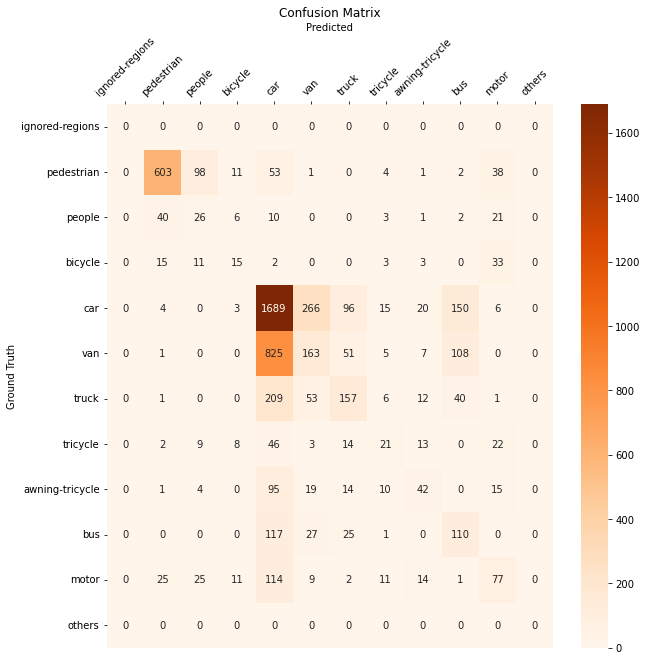

In [22]:
'''
Plot a confusion matrix
'''

test_size = 500
create_CSV(dir_test,test_size,'test.csv',class_dict)


csv_classes = 'classes.csv'
# Create the data loader

dataset_test = CSVDataset(train_file='test.csv', class_list=csv_classes,transform=transforms.Compose([normalizer, augmenter, resizer]))

sampler_test = AspectRatioBasedSampler(dataset_test, batch_size=1,     drop_last=False)
dataloader_test = DataLoader(dataset_test, num_workers=3, collate_fn=collater, batch_sampler=sampler_test)

# Load the model
retinanet = torch.load('trained_model/{}'.format(best_performance))
retinanet = retinanet.cuda()
retinanet.eval()

APs, confusion_matrix = csv_eval.evaluate_confusion_matrix(dataset_test, retinanet)
APs = list(APs.values())
APs = [float(tup[0]) for tup in APs]
mAP = sum(APs)/len(APs)
print('mAP: {}'.format(mAP))

#print(confusion_matrix)
confm = []
for k1, v in confusion_matrix.items():
    confm.append(list(v.values()))
confm = np.array(confm)


columns = list(class_dict.values())
df_cm = pd.DataFrame(confm, index=columns, columns=columns)

fig, ax = plt.subplots(figsize=(10,10))
ax1 = sn.heatmap(df_cm, cmap='Oranges', annot=True, ax=ax, fmt='d')
ax1.set(xlabel='Predicted',ylabel='Ground Truth',title='Confusion Matrix')
ax1.xaxis.set_label_position('top')
ax1.xaxis.tick_top()
plt.xticks(rotation=45)


The confusion matrix shows predicted classes versus the ground truth. The result is pretty good since most of the predictions are along the main diagonal. Note that there are many more pedestrians and cars than other classes due to the high class imbalance of the dataset. The model did mix up different vehicle classes like cars, vans, and trucks. I believe these misclassifications are not too big of a deal because the differences between a car with a van and a bus with a truck are pretty subtle.

#### 19. Calculate accuracy, precision and recall on the holdout dataset. Discuss which metric you think is most meaningful for this dataset, and why.

Accuracy cannot be calculated because $accuracy = \frac{true_{positive} + true_{negative}}{true_{positive} + true_{negative} + false_{positive} + false_{negative}}$ and $true_{negative}$ cannot be determined (as that is the bounding boxes that were not detected and do not exist in the annotations).

The most meaningful metric for object detection is typically Mean Average Precision (mAP). This score also accounts for the intersection over union (IoU), which measures how close the bounding box prediction is to the ground truth. The higher the mAP, the better the model.

In [194]:
'''
Test on the holdout set
'''
csv_classes = 'classes.csv'
# Create the data loader

dataset_test = CSVDataset(train_file='test.csv', class_list=csv_classes,transform=transforms.Compose([normalizer, augmenter, resizer]))

sampler_test = AspectRatioBasedSampler(dataset_test, batch_size=1,     drop_last=False)
dataloader_test = DataLoader(dataset_test, num_workers=3, collate_fn=collater, batch_sampler=sampler_test)

# Load the model
retinanet = torch.load('trained_model/{}'.format(best_performance))
retinanet = retinanet.cuda()
retinanet.eval()

APs = csv_eval.evaluate(dataset_test, retinanet)
APs = list(APs.values())
APs = [float(tup[0]) for tup in APs]
mAP = sum(APs)/len(APs)
print('mAP: {}'.format(mAP))

100/100
mAP:
ignored-regions: 0
Precision:  0.035443037974683546
Recall:  0.09395973154362416
pedestrian: 0.030838735543580357
Precision:  0.035443037974683546
Recall:  0.09395973154362416
people: 0.003899443366971494
Precision:  0.035443037974683546
Recall:  0.09395973154362416
bicycle: 0.018981481481481478
Precision:  0.035443037974683546
Recall:  0.09395973154362416
car: 0.0930530381290495
Precision:  0.035443037974683546
Recall:  0.09395973154362416
van: 0.00781539701913176
Precision:  0.035443037974683546
Recall:  0.09395973154362416
truck: 0.013728408449032822
Precision:  0.035443037974683546
Recall:  0.09395973154362416
tricycle: 0.00024330900243309
Precision:  0.035443037974683546
Recall:  0.09395973154362416
awning-tricycle: 0.003345782757547464
Precision:  0.035443037974683546
Recall:  0.09395973154362416
bus: 0.0
Precision:  0.035443037974683546
Recall:  0.09395973154362416
motor: 0.007885420314617326
Precision:  0.035443037974683546
Recall:  0.09395973154362416
others: 0
Pr

#### 20. Discuss how the model performance on holdout compares to the model performance during training. Do you think your model will generalize well? Why or why not?

The final model performance had an mAP of 0.01498, compared to the mAP on the validation set of 0.0305. Yes I believe the model will generalize, since the order of magnitude of the mAP is the same.

#### 38. Correctly make predictions with your model (the predictions can be wrong).

#### 49. Generate a dataset of just ~~three~~ (10 in my dataset) items, and show your model correctly labels them. (display each item in your notebook, pass it to your model, and then print the predictions).

In [16]:
'''
Create CSV file with 10 different images, one for each class
'''
df_labels = pd.read_csv('test.csv')
df_labels.columns = ['img_path', 'x1', 'y1', 'x2', 'y2', 'label']
classes = class_dict.values()
class_imgs = {}
num_classes = len(classes)

for c in enumerate(list(classes)[1:11]):
    df_class = df_labels[df_labels['label'] == c[1]]

    for idx,row in df_class.iterrows():
        if row['img_path'] not in class_imgs.values():
            class_imgs[c] = row['img_path']
            break

# create csv with those images
imgs_10 = list(class_imgs.values())
df_10 = df_labels[df_labels['img_path'].isin(imgs_10)]
df_10_name = 'test_10.csv'
df_10.to_csv(df_10_name,header=False,index=False)

Image with pedestrian:


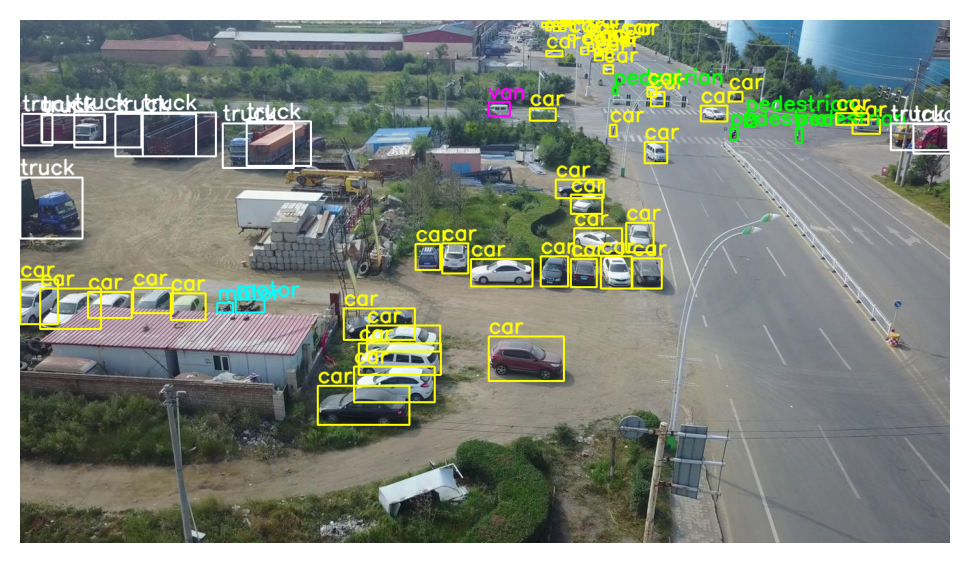

Image with people:


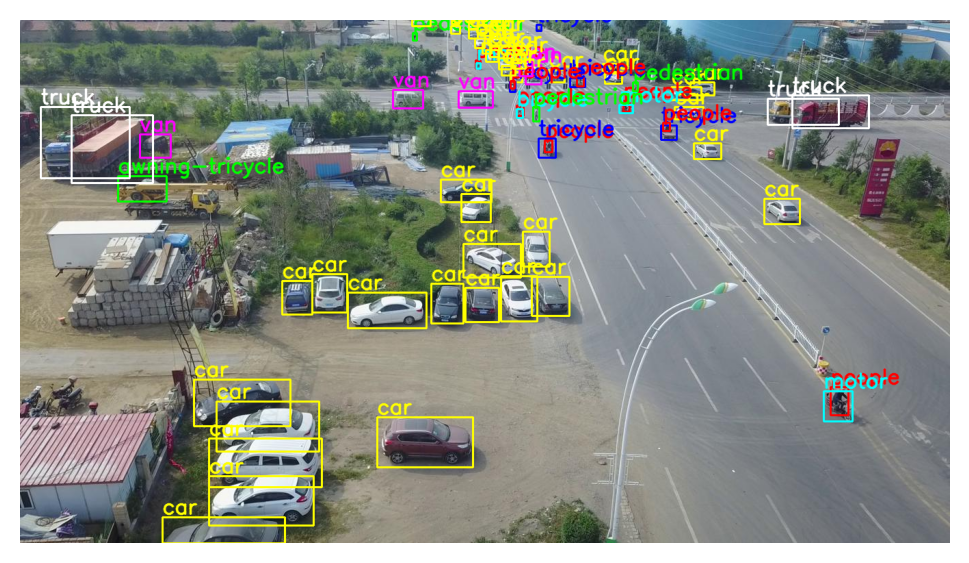

Image with car:


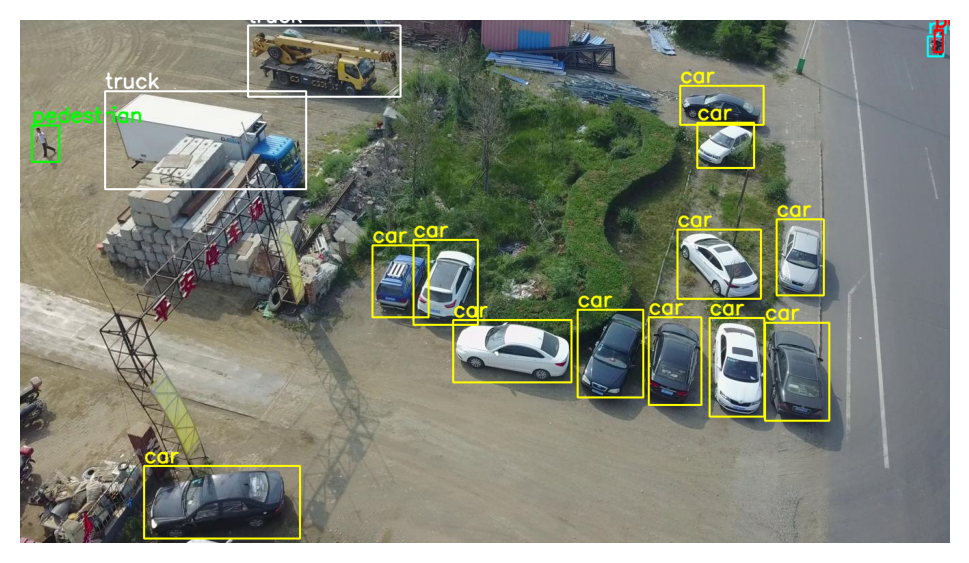

Image with van:


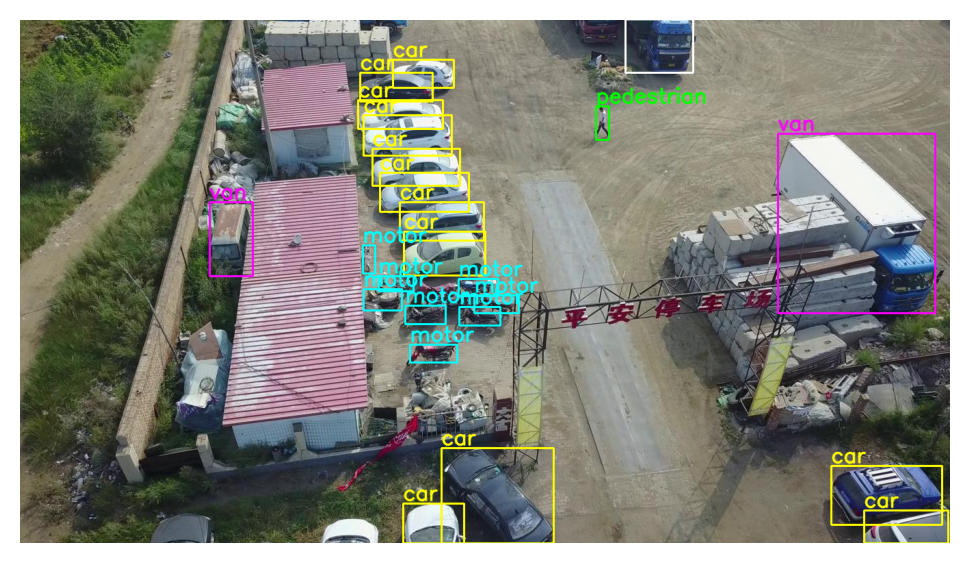

Image with truck:


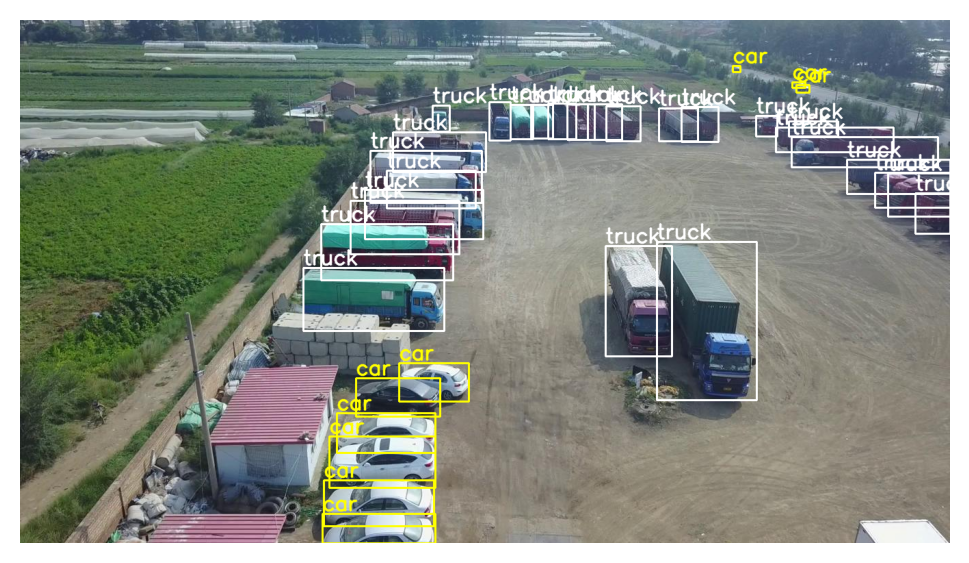

Image with tricycle:


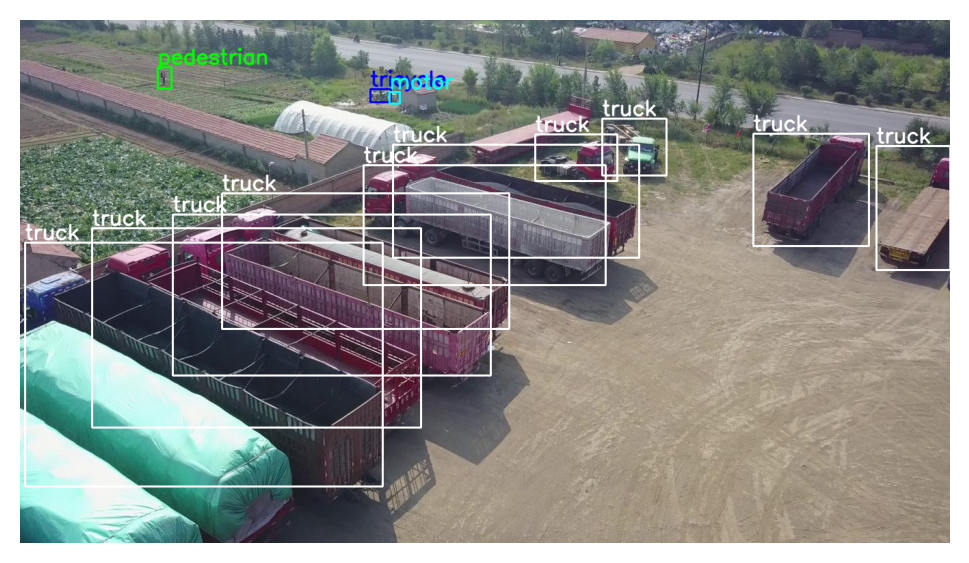

Image with motor:


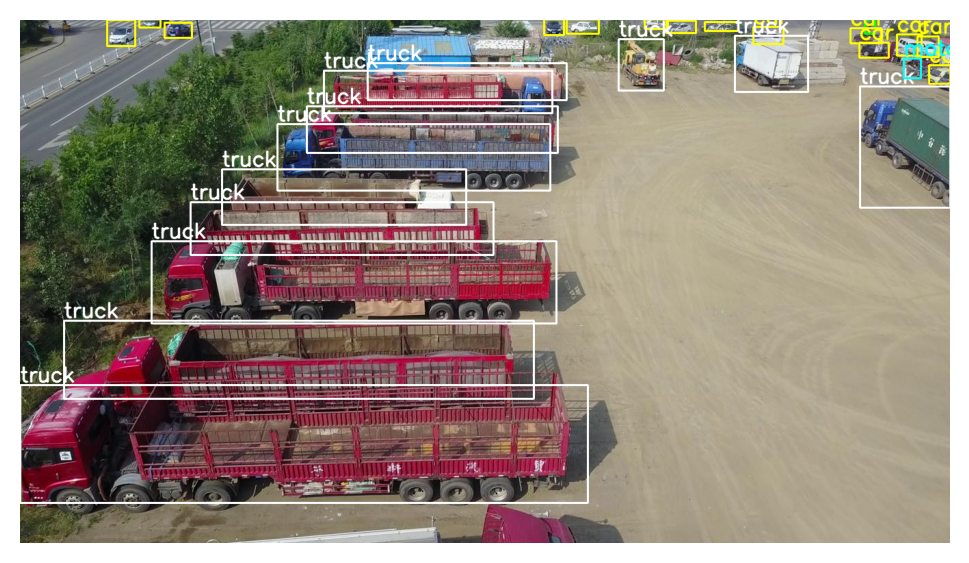

Image with bicycle:


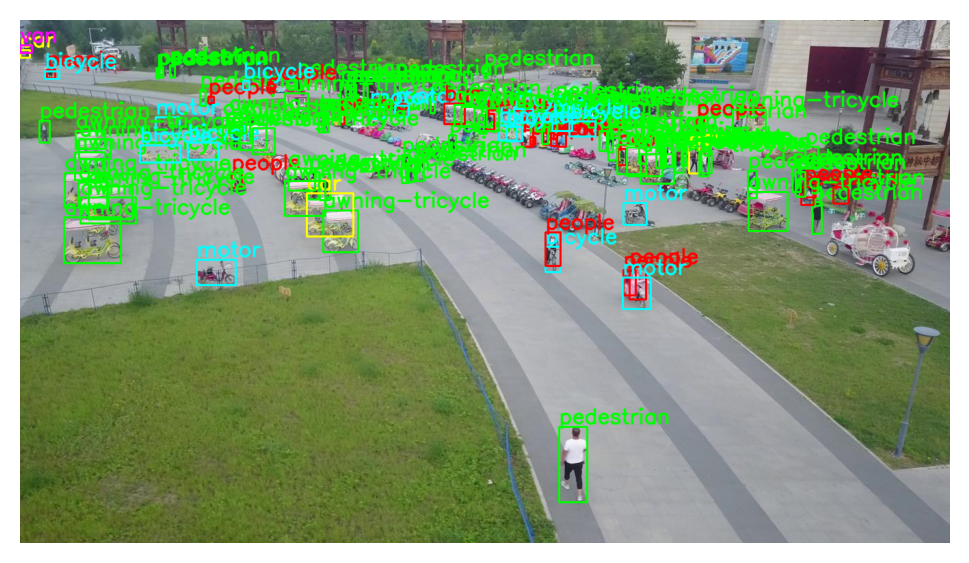

Image with awning-tricycle:


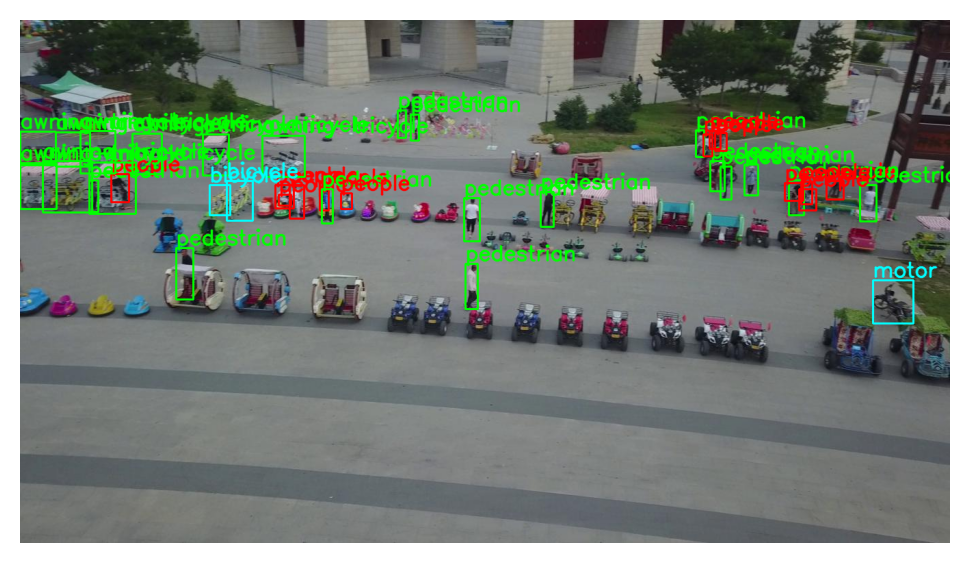

Image with bus:


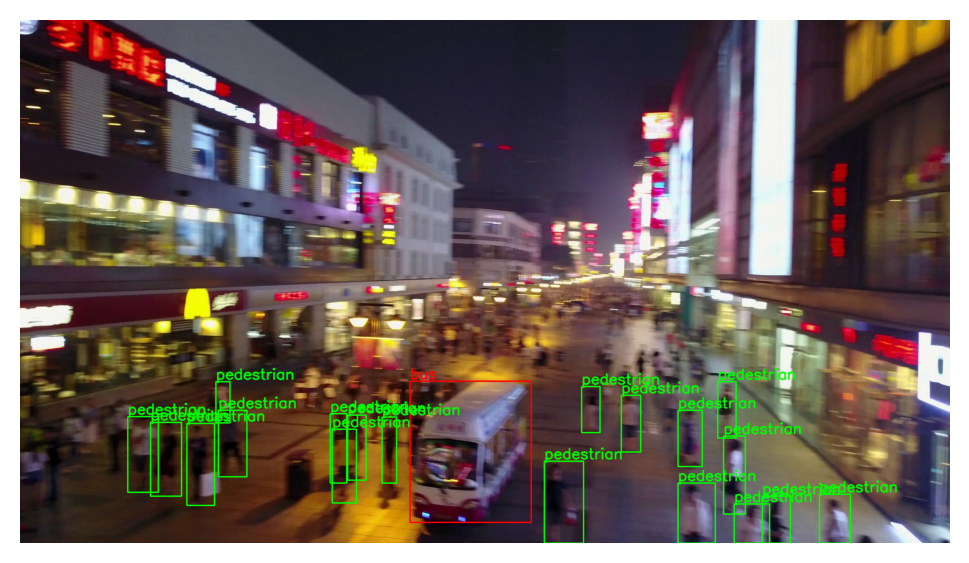

In [21]:
'''
Display the ground truth bounding boxes for each image
'''
order = []
for img_path in list(df_10['img_path'].unique()):
    category = ''
    for c, img in class_imgs.items():
        if img == img_path:
            category = c
            order.append(category[1])
    np_img = cv2.imread(img_path)

    anno_path = img_path.replace('images','annotations').replace('jpg','txt')
    img_label = create_label(anno_path)
    print('Image with {}:'.format(category[1]))
    annotate_img(np_img, img_label, class_dict)

Prediction on image with pedestrian
Elapsed time: 0.05449986457824707


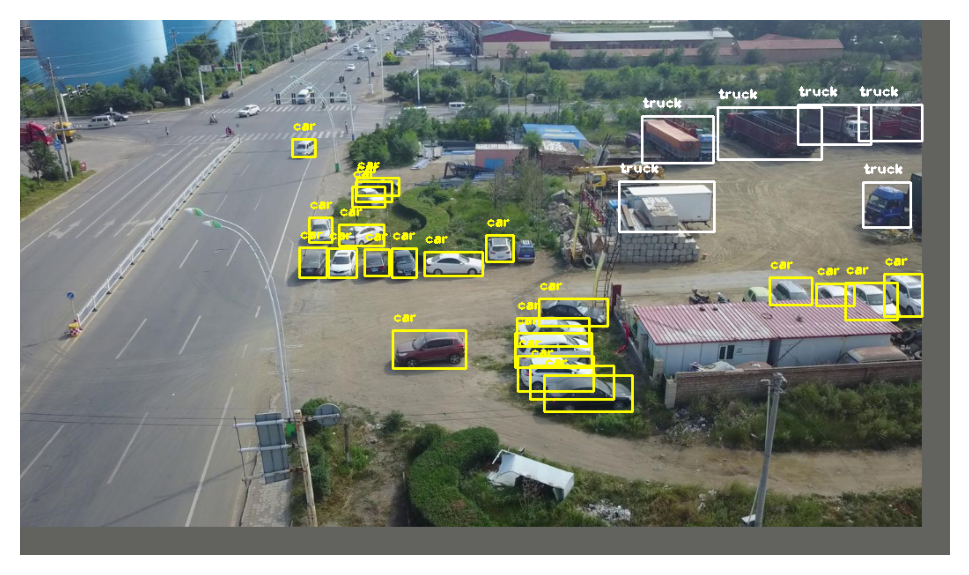

Prediction on image with people
Elapsed time: 0.050722360610961914


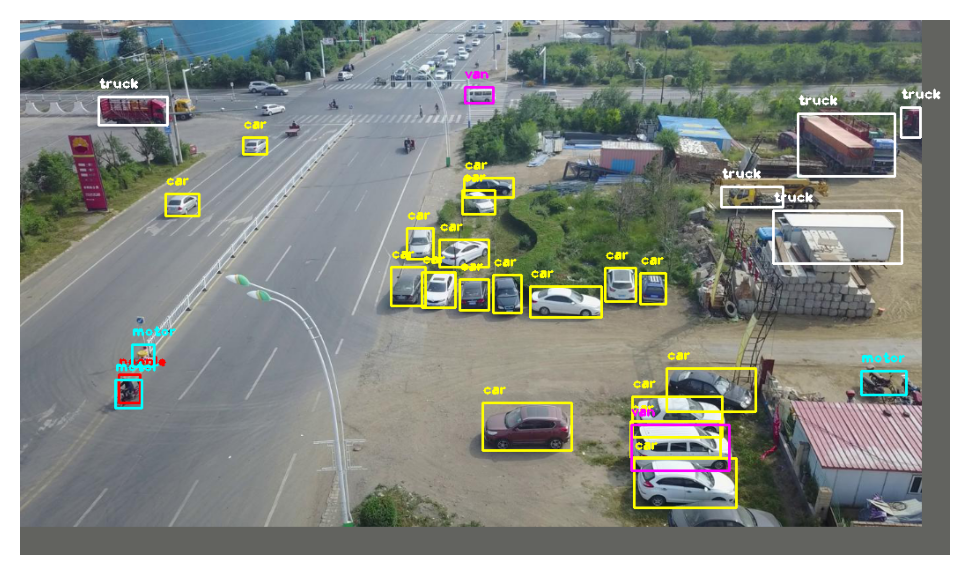

Prediction on image with car
Elapsed time: 0.051328182220458984


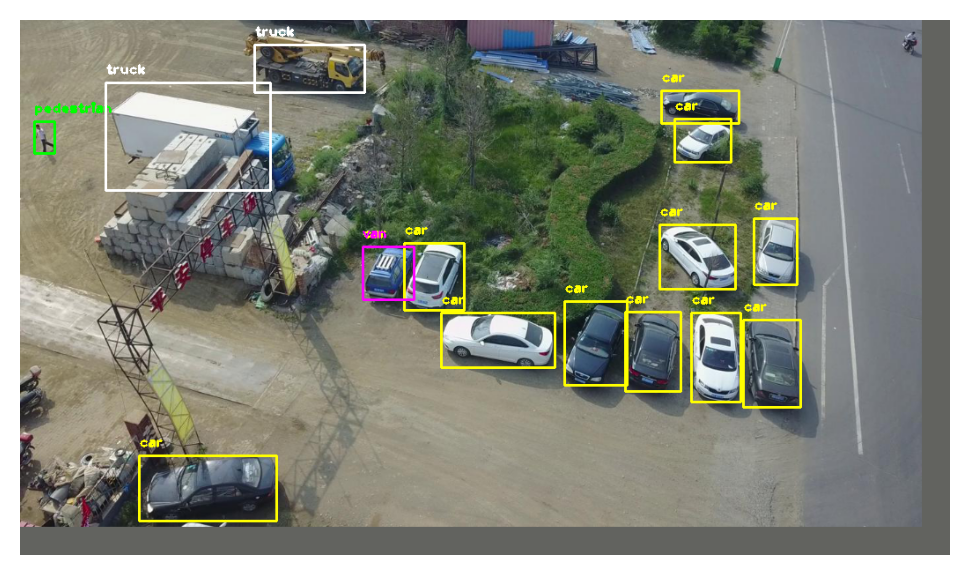

Prediction on image with van
Elapsed time: 0.05115866661071777


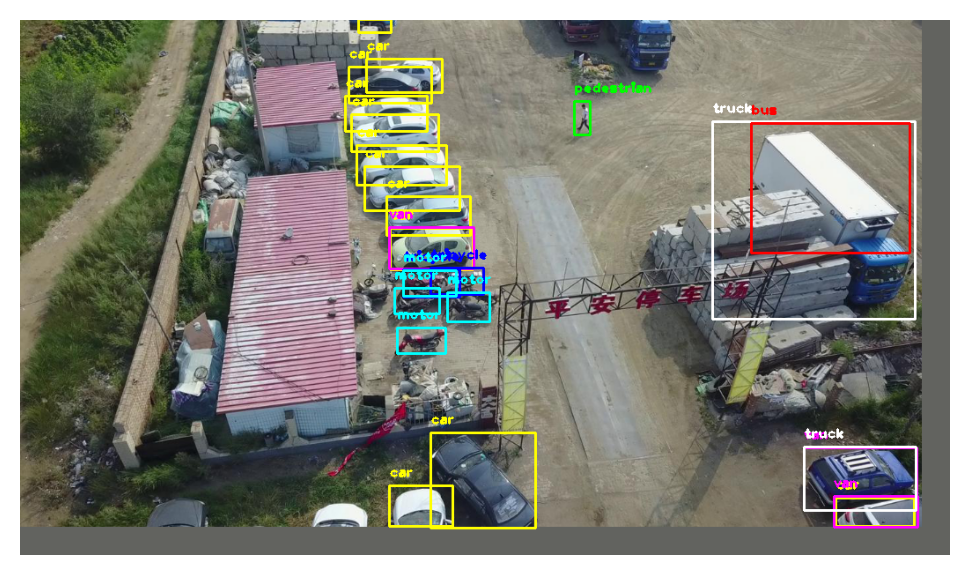

Prediction on image with truck
Elapsed time: 0.05021262168884277


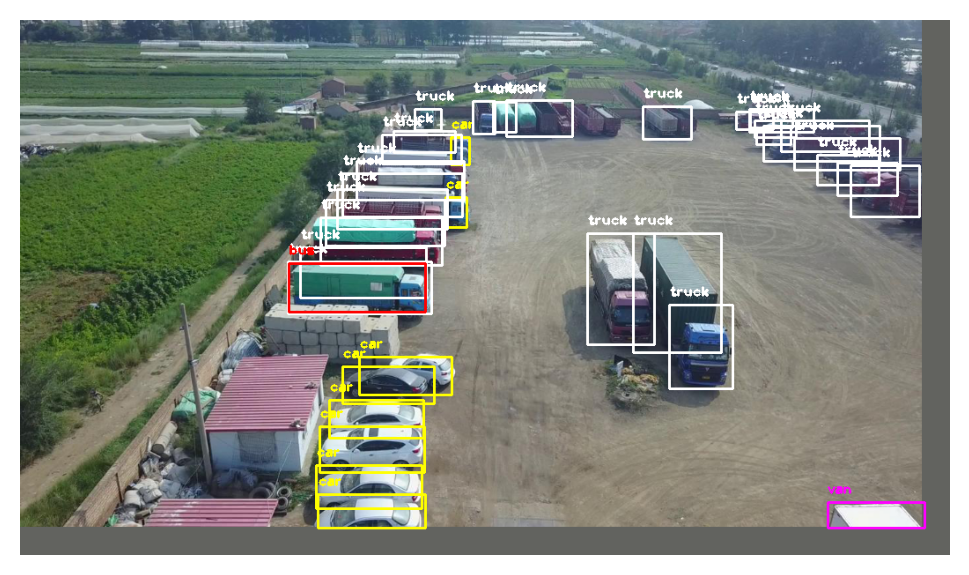

Prediction on image with tricycle
Elapsed time: 0.04906821250915527


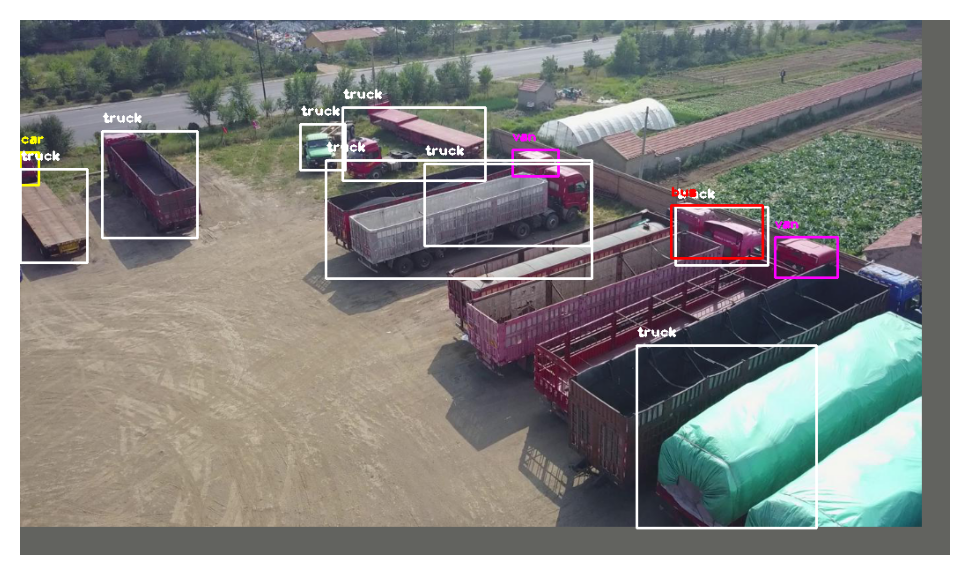

Prediction on image with motor
Elapsed time: 0.05106353759765625


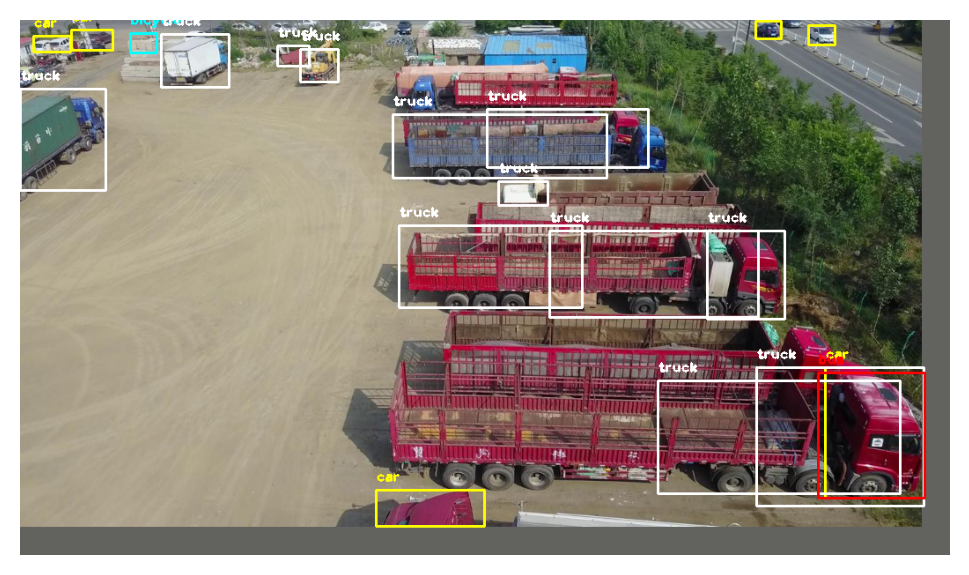

Prediction on image with bicycle
Elapsed time: 0.05160069465637207


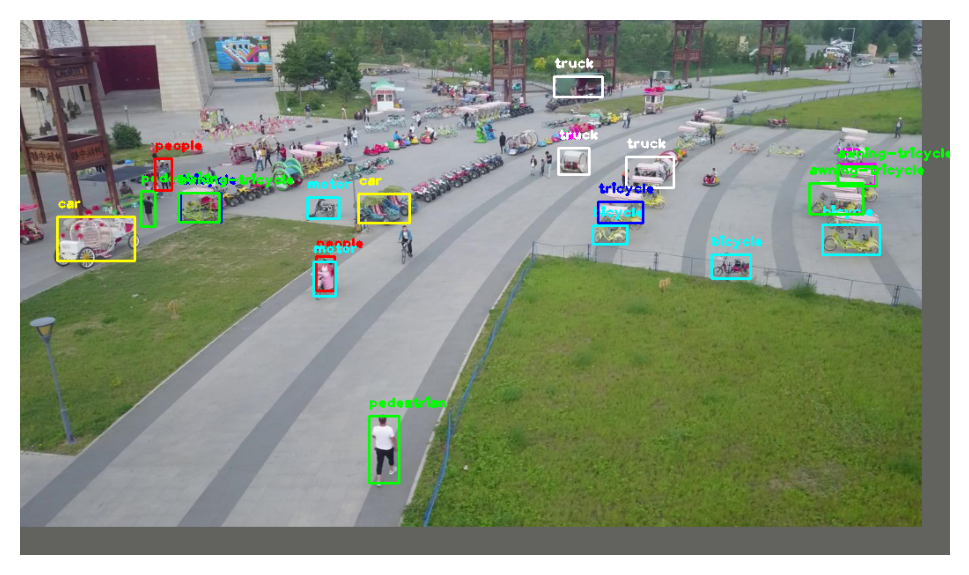

Prediction on image with awning-tricycle
Elapsed time: 0.05128622055053711


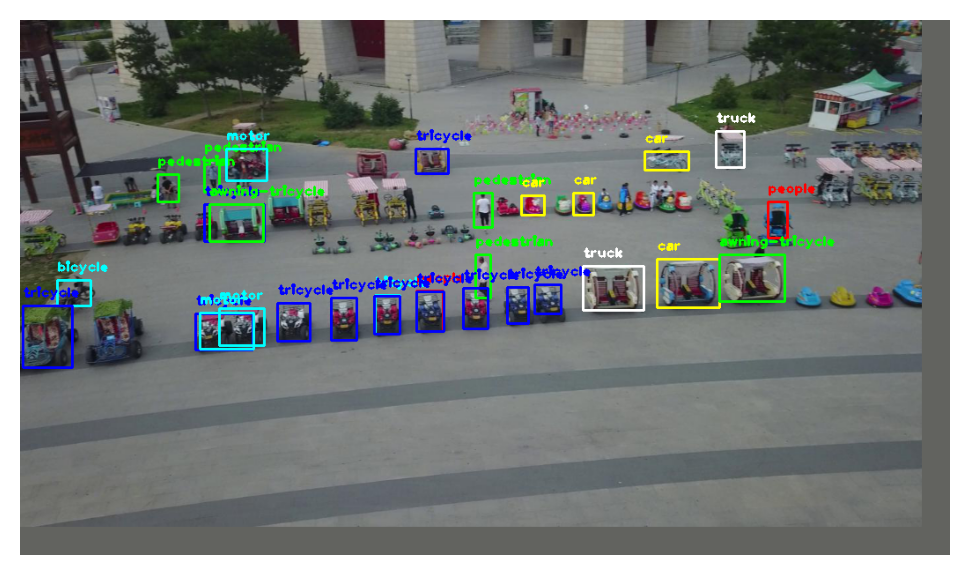

Prediction on image with bus
Elapsed time: 0.05166912078857422


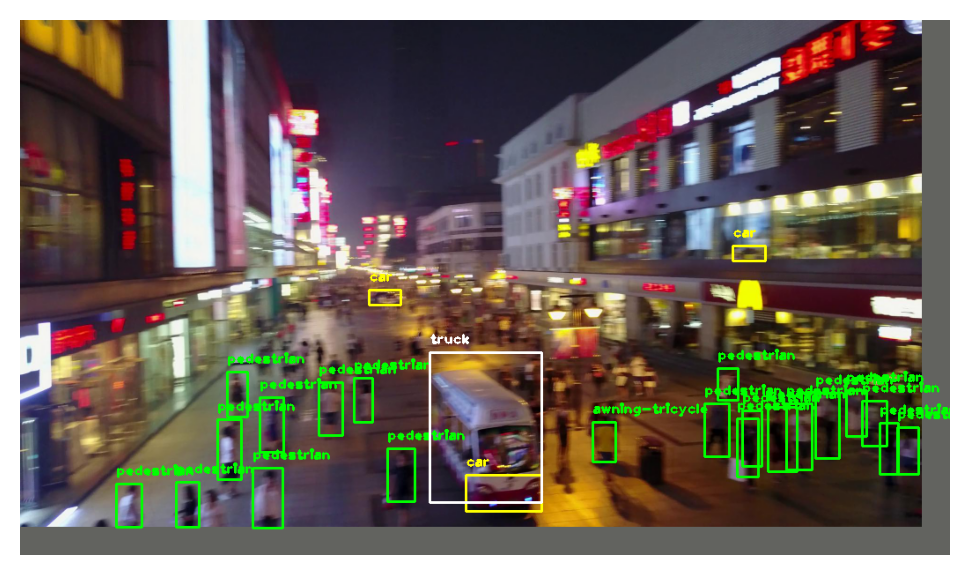

In [23]:
colors = [(255,0,0), (0,255,0), (0,0,255), (255,255,0), (0,255,255), (255,0,255), (255,255,255)]

csv_classes = 'classes.csv'
dataset_test = CSVDataset(train_file=df_10_name, class_list=csv_classes,transform=transforms.Compose([normalizer, augmenter, resizer]))

sampler_test = AspectRatioBasedSampler(dataset_test, batch_size=1,drop_last=False,shuffle=False)
dataloader_test = DataLoader(dataset_test, num_workers=1, collate_fn=collater, batch_sampler=sampler_test)

def draw_caption(image, box, caption, color):
    b = np.array(box).astype(int)
    cv2.putText(image, caption, (b[0], b[1] - 10), cv2.FONT_HERSHEY_PLAIN, 1, color, 2)

# Load the model
retinanet = torch.load('trained_model/model_final.pt')
retinanet = retinanet.cuda()
retinanet.eval()

unnormalize = UnNormalizer(mean,std)

for idx, data in enumerate(dataloader_test):
    print('Prediction on image with {}'.format(order[idx]))
    with torch.no_grad():
        st = time.time()
        if torch.cuda.is_available():
            scores, classification, transformed_anchors = retinanet(data['img'].cuda().float())
        else:
            scores, classification, transformed_anchors = retinanet(data['img'].float())
        print('Elapsed time: {}'.format(time.time() - st))
        idxs = np.where(scores.cpu() > 0.5)

        img = np.array(255 * unnormalize(data['img'][0, :, :, :])).copy()

        img[img < 0] = 0
        img[img > 255] = 255

        img = np.transpose(img, (1, 2, 0))

        img = cv2.cvtColor(img.astype(np.uint8), cv2.COLOR_BGR2RGB)

        for j in range(idxs[0].shape[0]):
            bbox = transformed_anchors[idxs[0][j], :]
            x1 = int(bbox[0])
            y1 = int(bbox[1])
            x2 = int(bbox[2])
            y2 = int(bbox[3])
            label_name = dataset_test.labels[int(classification[idxs[0][j]])]

            color = colors[int(classification[idxs[0][j]])%len(colors)]

            draw_caption(img, (x1, y1, x2, y2), label_name, color)

            cv2.rectangle(img, (x1, y1), (x2, y2), color=color, thickness=2)
        cv2_imshow(img)


#### 46. Make a list of reasons why your model may have under-performed.
- The model was only trained on 100 epochs
- The hyperparameters could be more optimal
- The large class imbalance
- Challenging dataset with some very small and very large objects
- Limitation of the model on recognizing small objects

#### 47. Make a list of ways you could improve your model performance (you don't have to implement these unless you want to).
- Increase the size of the dataset
- Introduce more images of the rarer classes
- Train for more epochs
- Select more optimal parameters using a more extensive hyperparameter gridsearch

#### 56. Correctly implement saliency maps for all images. If doing text or tabular data, discuss feature importances or other metric.

In [102]:
import cv2
import numpy as np

def add_transparent_image(background, foreground, x_offset=None, y_offset=None):
    '''
    Source: https://stackoverflow.com/questions/40895785/using-opencv-to-overlay-transparent-image-onto-another-image
    '''

    bg_h, bg_w, bg_channels = background.shape
    fg_h, fg_w, fg_channels = foreground.shape

    assert bg_channels == 3, f'background image should have exactly 3 channels (RGB). found:{bg_channels}'
    assert fg_channels == 4, f'foreground image should have exactly 4 channels (RGBA). found:{fg_channels}'

    # center by default
    if x_offset is None: x_offset = (bg_w - fg_w) // 2
    if y_offset is None: y_offset = (bg_h - fg_h) // 2

    w = min(fg_w, bg_w, fg_w + x_offset, bg_w - x_offset)
    h = min(fg_h, bg_h, fg_h + y_offset, bg_h - y_offset)

    if w < 1 or h < 1: return

    # clip foreground and background images to the overlapping regions
    bg_x = max(0, x_offset)
    bg_y = max(0, y_offset)
    fg_x = max(0, x_offset * -1)
    fg_y = max(0, y_offset * -1)
    foreground = foreground[fg_y:fg_y + h, fg_x:fg_x + w]
    background_subsection = background[bg_y:bg_y + h, bg_x:bg_x + w]

    # separate alpha and color channels from the foreground image
    foreground_colors = foreground[:, :, :3]
    alpha_channel = foreground[:, :, 3] / 255  # 0-255 => 0.0-1.0

    # construct an alpha_mask that matches the image shape
    alpha_mask = np.dstack((alpha_channel, alpha_channel, alpha_channel))

    # combine the background with the overlay image weighted by alpha
    composite = background_subsection * (1 - alpha_mask) + foreground_colors * alpha_mask

    # overwrite the section of the background image that has been updated
    background[bg_y:bg_y + h, bg_x:bg_x + w] = composite

Prediction on image with pedestrian
Elapsed time: 22173.16283941269


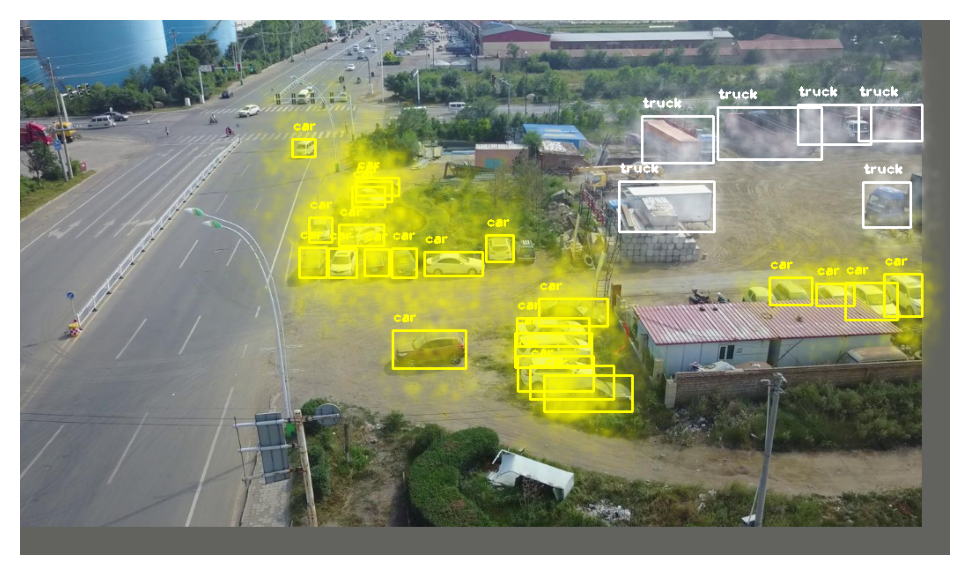

Prediction on image with people
Elapsed time: 22189.968139648438


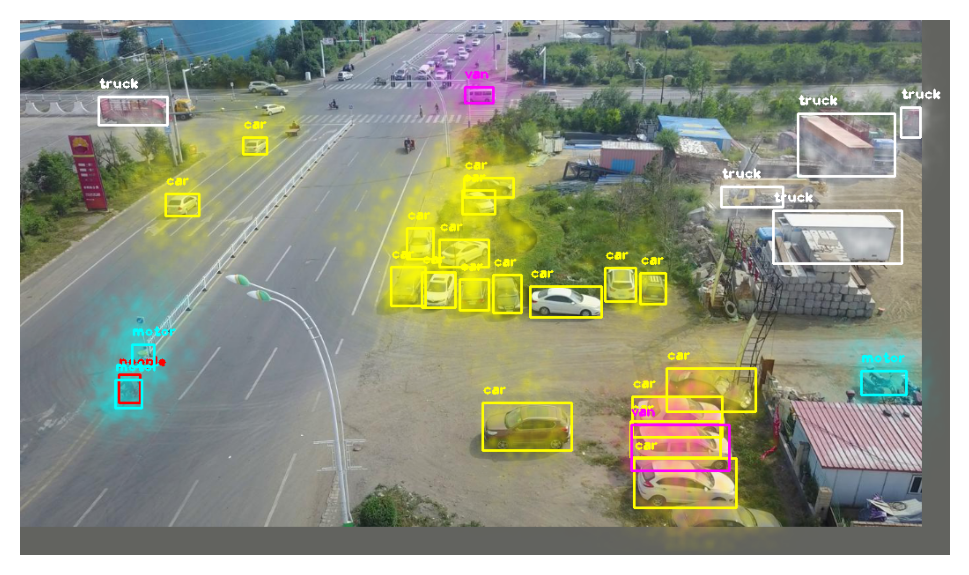

Prediction on image with car
Elapsed time: 22200.574661254883


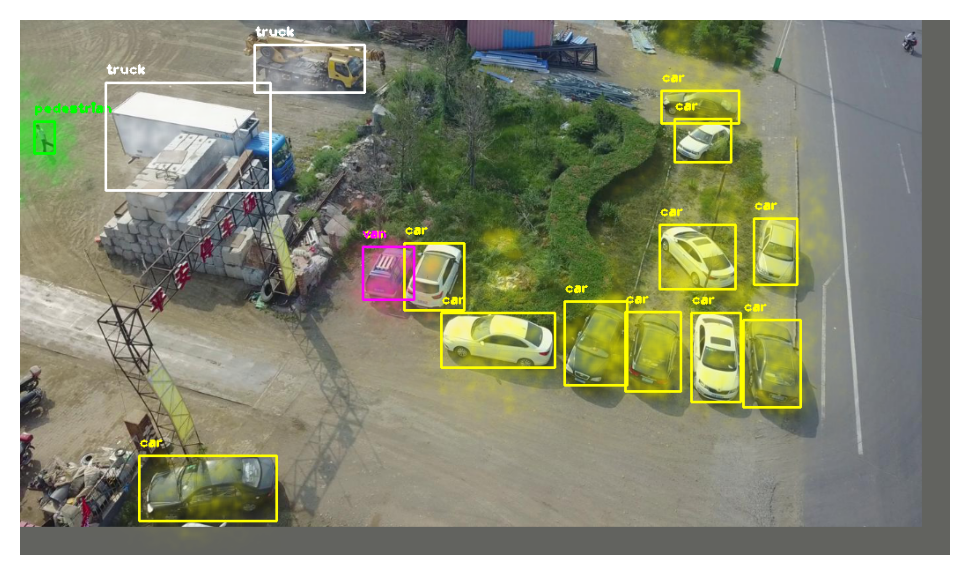

Prediction on image with van
Elapsed time: 22216.278758764267


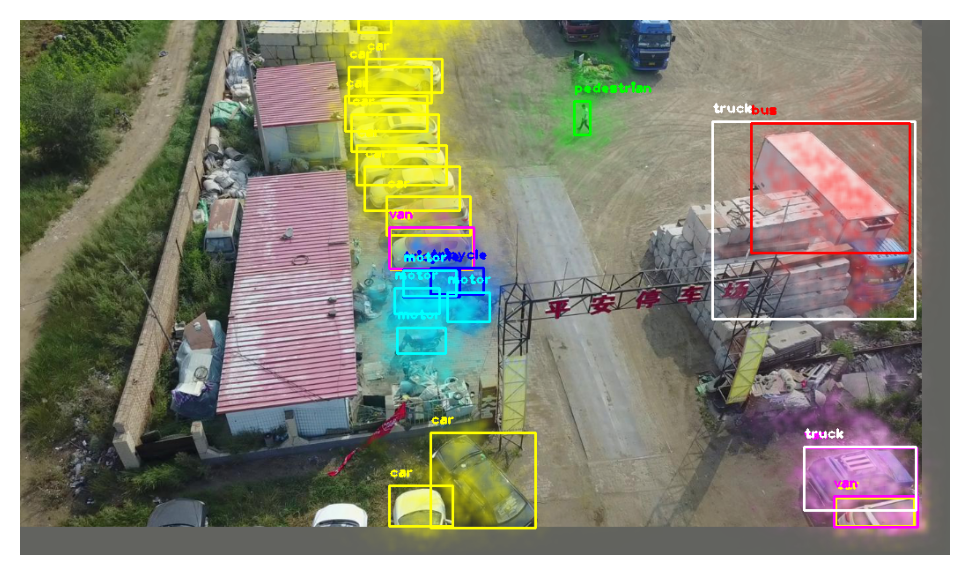

Prediction on image with truck
Elapsed time: 22238.435944080353


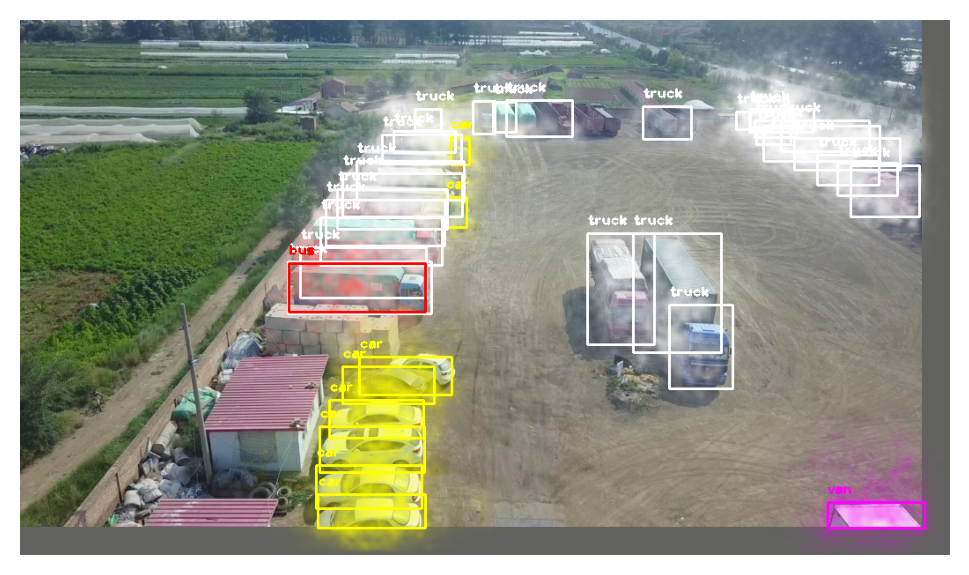

Prediction on image with tricycle
Elapsed time: 22246.0878739357


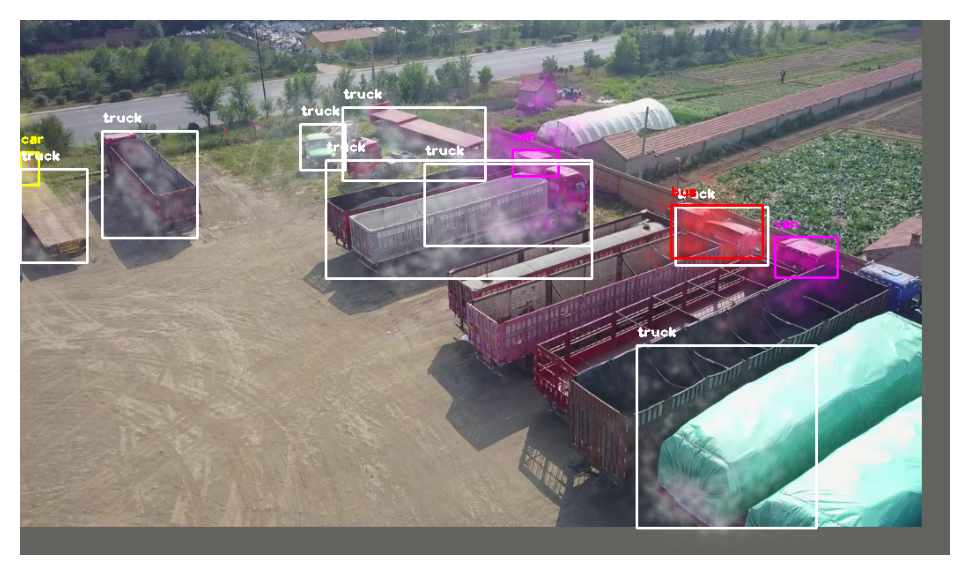

Prediction on image with motor
Elapsed time: 22259.773947000504


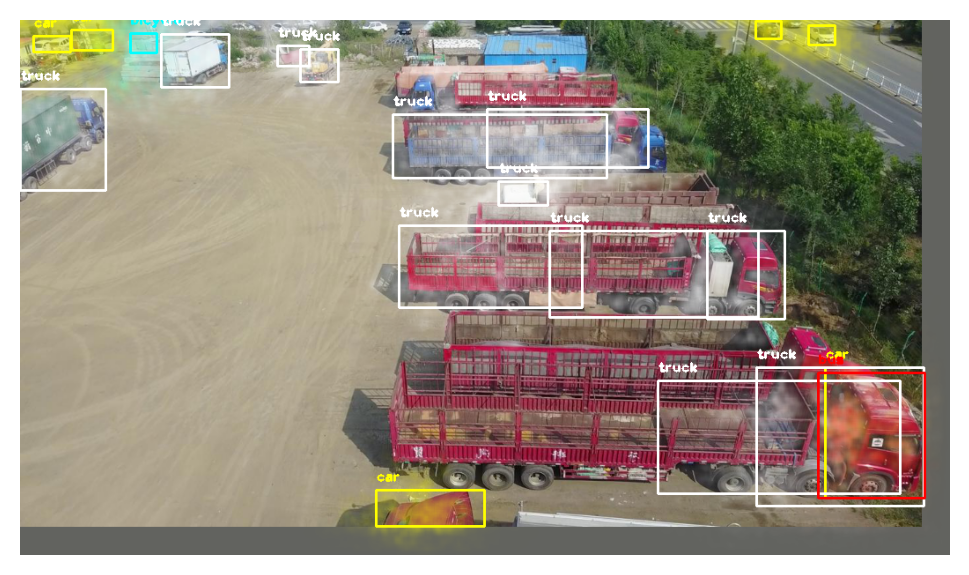

Prediction on image with bicycle
Elapsed time: 22274.85538625717


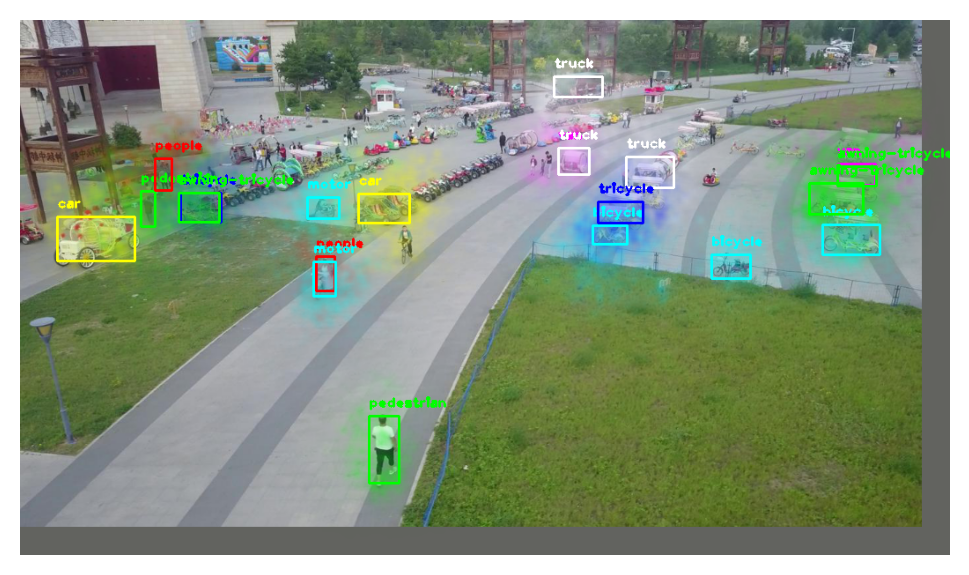

Prediction on image with awning-tricycle
Elapsed time: 22298.916592121124


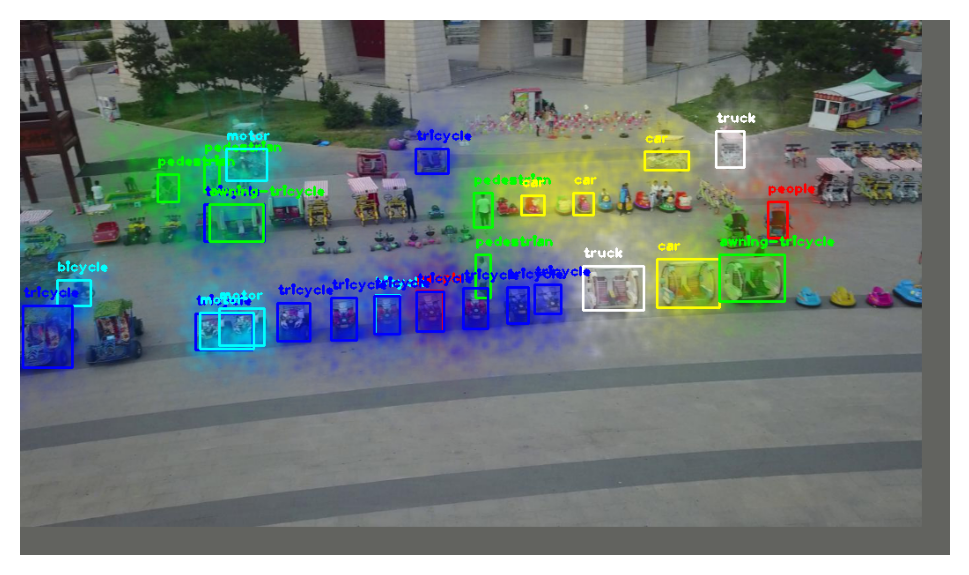

Prediction on image with bus
Elapsed time: 22318.677796125412


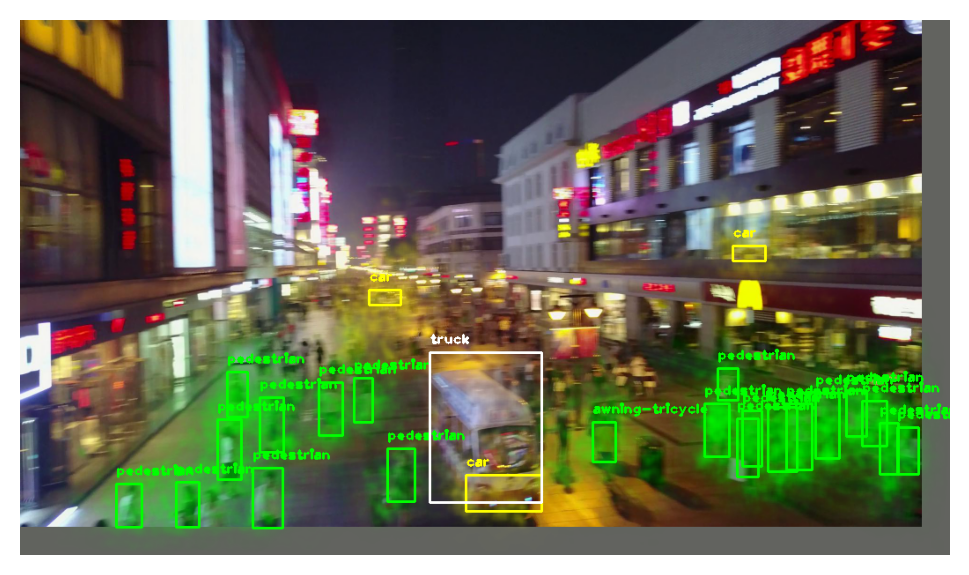

In [193]:
'''
Implement saliency map
'''

colors = [(255,0,0), (0,255,0), (0,0,255), (255,255,0), (0,255,255), (255,0,255), (255,255,255)]

csv_classes = 'classes.csv'
dataset_test = CSVDataset(train_file=df_10_name, class_list=csv_classes,transform=transforms.Compose([normalizer, augmenter, resizer]))

sampler_test = AspectRatioBasedSampler(dataset_test, batch_size=1,drop_last=False,shuffle=False)
dataloader_test = DataLoader(dataset_test, num_workers=1, collate_fn=collater, batch_sampler=sampler_test)

def draw_caption(image, box, caption, color):
    b = np.array(box).astype(int)
    cv2.putText(image, caption, (b[0], b[1] - 10), cv2.FONT_HERSHEY_PLAIN, 1, color, 2)

# Load the model
retinanet = torch.load('trained_model/model_final.pt')
retinanet = retinanet.cuda()
retinanet.eval()

unnormalize = UnNormalizer(mean,std)

for i, data in enumerate(dataloader_test):
    print('Prediction on image with {}'.format(order[i]))

    # Load the image
    img = np.array(255 * unnormalize(data['img'].clone()[0, :, :, :])).copy()
    img[img < 0] = 0
    img[img > 255] = 255
    img = np.transpose(img, (1, 2, 0))
    img = cv2.cvtColor(img.astype(np.uint8), cv2.COLOR_BGR2RGB)


    idx = 0
    while True:
        if torch.cuda.is_available():
            image = data['img'].cuda().float()
        else:
            image = data['img'].float()

        # save gradient of image
        image.requires_grad_()
        scores, classification, transformed_anchors = retinanet(image)

        # only repeat saliency by the number of predictions
        if idx >= len(scores):
            break

        cur_pred = scores[idx]
        if cur_pred < 0.5:
            idx += 1
            continue

        # get the class
        cls_idx = classification[idx]
        # Do backpropagation to get the derivative of the output based on the image
        cur_pred.backward()
        idx += 1

        # Retrieve the saliency map and also pick the maximum value from channels on each pixel.
        # In this case, we look at dim=1. Recall the shape (batch_size, channel, width, height)
        saliency, _ = torch.max(image.grad.data.abs(), dim=1)
        saliency = saliency[0]
        saliency = saliency.cpu().numpy()

        saliency = cv2.normalize(saliency,None,0,255,cv2.NORM_MINMAX,cv2.CV_8U)
        #cv2_imshow(saliency)

        color = colors[cls_idx%len(colors)]

        colored = np.zeros((saliency.shape[0],saliency.shape[1],4))
        colored[:,:,0] = color[0]
        colored[:,:,1] = color[1]
        colored[:,:,2] = color[2]
        colored[:,:,3] = saliency**1.3 #emphasize higher values more

        colored = colored.astype(np.uint8)
        colored = cv2.GaussianBlur(colored,(9,9),cv2.BORDER_DEFAULT)



        # Visualize the image and the saliency map
        add_transparent_image(img, colored)


    #cv2_imshow(img)



    print('Elapsed time: {}'.format(time.time() - st))
    idxs = np.where(scores.cpu() > 0.5)


    for j in range(idxs[0].shape[0]):
        bbox = transformed_anchors[idxs[0][j], :]
        x1 = int(bbox[0])
        y1 = int(bbox[1])
        x2 = int(bbox[2])
        y2 = int(bbox[3])
        label_name = dataset_test.labels[int(classification[idxs[0][j]])]

        color = colors[int(classification[idxs[0][j]])%len(colors)]

        draw_caption(img, (x1, y1, x2, y2), label_name, color)

        cv2.rectangle(img, (x1, y1), (x2, y2), color=color, thickness=2)
    cv2_imshow(img)


#### 57. Discussion of saliency mapping or other metric from above.

The saliency mapping showed the importance of each pixel in the prediction of a bounding box. I colored each of the salient pixels to match the corresponding bounding box color. I also overlaid the saliency map over the image and bounding box predictions. I ran the saliency maps on each of the images of the 9 classes. The result was good, with most of the salient pixels coming from withing the bounding boxes. This suggests that the model was learning the correct features in the image.

#### 52. Take a look at each of the items in all classes individually. What aspects of the item (such as backgrounds) might be influencing the decision-making of the model, besides the salient parts themselves?

Some aspects might be the lighting conditions of the image. In the night time images, it may be hard to pick out smaller objects in the image than in daytime photos.

Also, the angle of the camera may have an influence. Some images are taken from more of a birds eye perspective, while others are more horizontal. Classes like the pedestrian are easier to identify from a side profile because it is more distinct than an overhead view where the person appears as a dot.

#### 53. Is the data biased in any way that could impact your results? Why or why not?
One way the data is biased is some classes are naturally smaller than others.  For example, trucks will have a larger bounding box size than pedestrians. This introduces a bias because if an object is too small (e.g. only a few pixels wide), then the model probably won't be able to recognize it.

The dataset is also biased because some classes look more similar to each other than others. For example cars and vans look very similar while a bus and a pedestrian look very different. This means the car and van are more likely to get confused than pedestrians and busses.

#### 54. If you noted some potential biases in the modeling/dataset above, discuss how you could help mitigate these biases (you don't need to implement, just discuss). If you didn't note any biases in this dataset, discuss what biases there could have been, and how the dataset designers might have helped mitigate them.

The issue of class size (in pixels) can be mitigated by introducing a scaling factor based on the elevation of the image that will augment the dataset by zooming in on certain locations. This will increase the resolution of the smaller classes and make them easier to recognize.

The class imbalance issue can be prevented by using data augmentation for the less common classes.

#### 55. Correctly train your model without pre-training (and discussion how this affects performance)

I trained this model over 5 epochs with the best hyperparameters selected from the grid search cross validation. This model had a mAP of 0.0011 which is about 10 times worse than the mAP of the model with with pre-training. This is expected, because the model has to learn object recognition from scratch versus using weights that have already been optimized for a similar task.

In [16]:
train_name = 'train_fold_0.csv'
valid_name = 'valid_fold_0.csv'
epochs = 5
learning_rate = 0.00001
batch_size = 2
patience = 3
model_name = 'without_pretraining.pt'


APs = train(train_name,valid_name,epochs,learning_rate,batch_size,patience,model_name,pretrained=False)
APs = list(APs.values())
APs = [float(tup[0]) for tup in APs]
mAP = sum(APs)/len(APs)
print('mAP: {}'.format(mAP))

Num training images: 400
Epoch: 0 | Iteration: 0 | Classification loss: 1.13041 | Regression loss: 1.04976 | Running loss: 2.18017
Epoch: 0 | Iteration: 1 | Classification loss: 9.66118 | Regression loss: 2.08198 | Running loss: 6.96166
Epoch: 0 | Iteration: 2 | Classification loss: 14.53980 | Regression loss: 2.28412 | Running loss: 10.24908
Epoch: 0 | Iteration: 3 | Classification loss: 1.32696 | Regression loss: 2.50145 | Running loss: 8.64392
Epoch: 0 | Iteration: 4 | Classification loss: 1.17650 | Regression loss: 1.86190 | Running loss: 7.52281
Epoch: 0 | Iteration: 5 | Classification loss: 1.11755 | Regression loss: 1.39300 | Running loss: 6.68743
Epoch: 0 | Iteration: 6 | Classification loss: 1.11724 | Regression loss: 1.09313 | Running loss: 6.04785
Epoch: 0 | Iteration: 7 | Classification loss: 1.13606 | Regression loss: 1.04756 | Running loss: 5.56482
Epoch: 0 | Iteration: 8 | Classification loss: 1.09063 | Regression loss: 1.12768 | Running loss: 5.19299
Epoch: 0 | Iteratio

### Extra Credit
Choose up to four related papers to your work, and summarize each one in a paragraph.

#### Computer Vision for Small UAS Onboard Pedestrian Detection
This is the primary paper that this research is inspired from. The paper discusses the use of deep learning based approaches for pedestrian detection via a drone camera. The researchers used a retinanet model trained on the VisDrone2019 dataset. The paper also discusses related work on object detection and a history of algorithms such as Histogram of Oriented Gradients (HOG) and SVM based classifiers.

#### Focal Loss for Dense Object Detection
This paper introduces a new network called Retinanet. The researcher's primary contribution is a new loss function called Focal Loss. This loss function introduces a factor to the standard cross entropy loss, which reduces the loss for well classified examples, and increases loss on hard, misclassified examples. The retinanet model uses a resnet50 backbone with a feature pyramid network (introduced in another paper). The classification and bounding boxes are additional sub-networks on each layer of the feature pyramid network. This allows the model to recognize objects of different bounding box sizes ranging from different levels of the feature pyramid network.

#### Feature Pyramid Networks for Object Detection
Feature pyramids are a type of hierarchical image pyramid that has been introduced to deep convolutional networks with marignal extra cost. The algorithm works by using the downsample feature maps of the convolutional neural network as the input to the layers of the feature pyramid network. Then the hierarchical structure is formed by upsampling the smaller maps and doing element-wise addition with layers at a larger hierarchy.

#### Deep Residual Learning for Image Recognition
This is a breakthrough paper that created deeper neural networks. The neural networks are called resnets. Traditionally, deep neural networks are difficult to train due to issues with back propagation of the gradients (vanishing and exploding gradients). This paper introduces shortcut layers that enable deep models to train quickly. It works by adding connections that skip over convolutional layers.

